# Modeing Rating and Reviews data

**PACKAGES**

In [50]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

import datetime

import os
import pickle
import time
from tqdm.notebook import tqdm

from fuzzywuzzy import fuzz
import textdistance

import statsmodels.api as sm
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

In [51]:
tqdm.pandas()
code_start = time.time()

C:\Users\asaid\Anaconda3\lib\site-packages\tqdm\std.py:658: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


**CODE PARAMETERS**

In [52]:
# PANDAS DISPLAY PARAMETERS
# Setting the number of maximum columns and rows to display
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 200)
# pd.set_option('display.width', None)
# pd.set_option('display.max_colwidth', 1)

In [4]:
# PATHS FOR RATINGS AND REVIEWS
input_reviews_dir_path = r'../data/raw_data/Rating and Reviews/'
output_reviews_dir_path = r'../data/clean_data/'

# PATHS FOR PRODUCT CATALOGUE
input_product_dir_path = r'../data/raw_data/Product Catalogue/'
output_product_dir_path = r'../data/clean_data/'

# PATHS FOR DEMAND
input_demand_dir_path = r'../data/raw_data/Demand Data/'
output_demand_dir_path = r'../data/clean_data/'

# PATHS FOR MAPPINGS
input_mappings_dir_path = r'../data/clean_data/'
output_mappings_dir_path = r'../data/clean_data/'

## Data Wrangling

**Quick explanation:**

We have 3 main datasets (cf the image in the next cell):

The demand data follows the official ELC formating. The granularity of the data is the following: *Brand*, *ItemID 4*, *Item Description*, *Major Category* (Makeup, Skincare, ...) > *Application* (Face, eyes, body, ...) > *Category* (Cleansers, Mascare, ...) > *Subcategory* (Volumizing, Lengthening, ...) > *Product Line* > *Sub Product Line*.

The Signals data is broken into *Product Catalogues* and *Ratings and Reviews*. *Product Catalogues* contain data about the products. Ratings and Reviews contain data about reviews (EZ). Each of the two are broken into 2 *Major Categories*, I call these *Types*: *skincare* and *cosmetics*. The granularity of the data is *Brand*, *Sub Category* (also called *ELC Solution Type*) (lipstick, gloss etc.) and *Item description* (also called *Product* or *Product Name*.


Our goal is to link key to link Ratings & Reviews with the Product Catalogue using as key *type+channel+source_product_id* then link that to the demand.

Linking the Signals data with the demand data is tricky because none of the keys uses the official ELC format. Therefore, we used Fuzzy Matching to map the Brands and the Item Descritpions (Product Names). The  ELC solution typare that is supposed to correspond to the subcategories are too vague and I do not trust how Signals scrapped/assigned them. As for the types, Signals have Cosmetics and Skincare while ELC has Makeup, Skincare, Fragrance, Haircair etc. I do not trust this mapping either although we might have to use if Brand and Item Description do not provide enough detail and precision. 

NB: The *Product Catalogues* and *Ratings and Reviews* files get uploaded to a shared folder once in a while. The *demand* data is downloaded from a certain server.

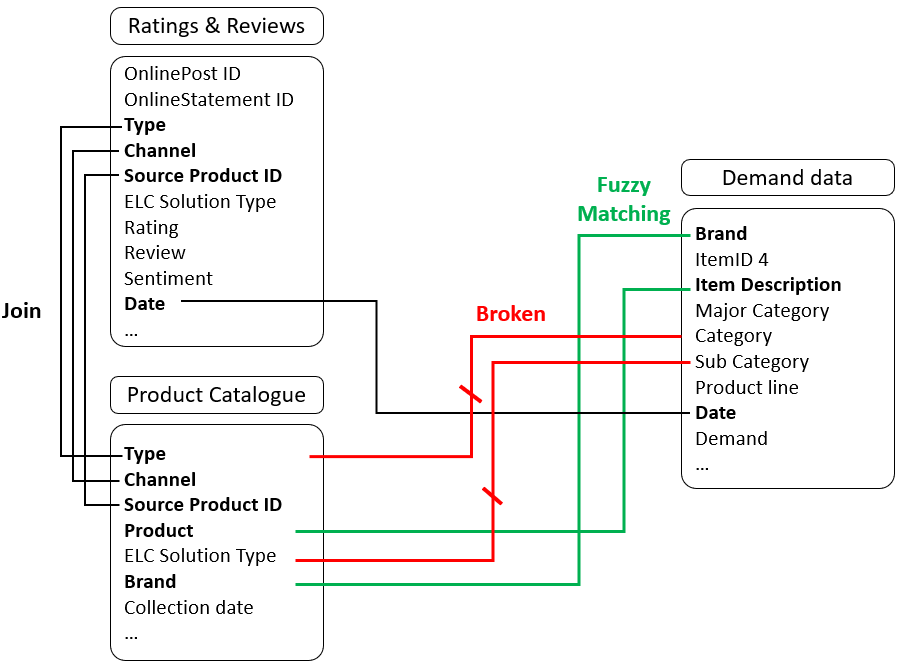

### Wrangling Demand Data

Before this code, I manually deleted the first row of the xlsx file that is downloaded from the server and saved it as a .csv file. A lot of formating needs to be done to transform the data into a Pandas friendly DataFrame.

#### Read data

In [5]:
# Read data
demand = pd.read_csv(os.path.join(input_demand_dir_path,'full_demand.csv'), encoding="ISO-8859-1")

#### Data description

The demand data is a bit messy, all the number are in text format. The brands are represented using abbreviations but we have a mapping between brands and there abbreviation. 

In [6]:
print("DATA SAMPLE:")
display(demand.sample(3))
print("DATA DESCRIPTION:")
display(demand.describe(include='all'))

DATA SAMPLE:


,Brand,ItemID 9,Item Description,Affiliate,Major Category ID,Major Category,Application ID,Application,Category ID,Category,Sub Category ID,Sub Category,Product Line ID,Product Line,Sub Product Line ID,Sub Product Line,Major Inventory,Inventory,7/1/2013,8/1/2013,9/1/2013,10/1/2013,11/1/2013,12/1/2013,1/1/2014,2/1/2014,3/1/2014,4/1/2014,5/1/2014,6/1/2014,7/1/2014,8/1/2014,9/1/2014,10/1/2014,11/1/2014,12/1/2014,1/1/2015,2/1/2015,3/1/2015,4/1/2015,5/1/2015,6/1/2015,7/1/2015,8/1/2015,9/1/2015,10/1/2015,11/1/2015,12/1/2015,1/1/2016,2/1/2016,3/1/2016,4/1/2016,5/1/2016,6/1/2016,7/1/2016,8/1/2016,9/1/2016,10/1/2016,11/1/2016,12/1/2016,1/1/2017,2/1/2017,3/1/2017,4/1/2017,5/1/2017,6/1/2017,7/1/2017,8/1/2017,9/1/2017,10/1/2017,11/1/2017,12/1/2017,1/1/2018,2/1/2018,3/1/2018,4/1/2018,5/1/2018,6/1/2018,7/1/2018,8/1/2018,9/1/2018,10/1/2018,11/1/2018,12/1/2018,1/1/2019,2/1/2019,3/1/2019,4/1/2019,5/1/2019,6/1/2019,7/1/2019,8/1/2019,9/1/2019,10/1/2019,11/1/2019,12/1/2019,1/1/2020,2/1/2020,3/1/2020,4/1/2020,5/1/2020,6/1/2020
31869,CM,277X010000,THE LOOSE POWDER,US,510,Makeup,25,Face,26,Face Powder,44,Loose Face Powder,248,Skin Color de la Mer,582,All Skin Color,Saleable,Standard Saleable,29,114,278,164,241,194,168,182,256,215,301,100,36,112,-,-,-,-,-,-,-,15,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-
22912,OR,0JMK040000,A PERF WRLD SPF 15 AGE DEF MOIST,US,510,Makeup,25,Face,30,All Other Face MakeU,33,All Other Face Makeu,320,A Perfect World,145,A Perfect World All Other,Saleable,Standard Saleable,4,2,3,2,2,8,4,3,8,5,10,7,1,3,5,10,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-
18332,AV,AEP6400000,TC RADIANCE MSQ,US,520,Skincare,25,Face,40,Face Masks,ZJ,All Other Masks,1,Aveda,76,(D) Tourmaline,Promotional,Samples,-,-,-,-,-,"3,216",-,-,-,"12,960",-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,"6,672",-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-


DATA DESCRIPTION:


,Brand,ItemID 9,Item Description,Affiliate,Major Category ID,Major Category,Application ID,Application,Category ID,Category,Sub Category ID,Sub Category,Product Line ID,Product Line,Sub Product Line ID,Sub Product Line,Major Inventory,Inventory,7/1/2013,8/1/2013,9/1/2013,10/1/2013,11/1/2013,12/1/2013,1/1/2014,2/1/2014,3/1/2014,4/1/2014,5/1/2014,6/1/2014,7/1/2014,8/1/2014,9/1/2014,10/1/2014,11/1/2014,12/1/2014,1/1/2015,2/1/2015,3/1/2015,4/1/2015,5/1/2015,6/1/2015,7/1/2015,8/1/2015,9/1/2015,10/1/2015,11/1/2015,12/1/2015,1/1/2016,2/1/2016,3/1/2016,4/1/2016,5/1/2016,6/1/2016,7/1/2016,8/1/2016,9/1/2016,10/1/2016,11/1/2016,12/1/2016,1/1/2017,2/1/2017,3/1/2017,4/1/2017,5/1/2017,6/1/2017,7/1/2017,8/1/2017,9/1/2017,10/1/2017,11/1/2017,12/1/2017,1/1/2018,2/1/2018,3/1/2018,4/1/2018,5/1/2018,6/1/2018,7/1/2018,8/1/2018,9/1/2018,10/1/2018,11/1/2018,12/1/2018,1/1/2019,2/1/2019,3/1/2019,4/1/2019,5/1/2019,6/1/2019,7/1/2019,8/1/2019,9/1/2019,10/1/2019,11/1/2019,12/1/2019,1/1/2020,2/1/2020,3/1/2020,4/1/2020,5/1/2020,6/1/2020
count,37119,37119,37119,37119,37119.000000,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119,37119
unique,21,37119,17712,1,NaN,5,23,23,94,93,212,208,418,418,1120,1118,2,6,3534,3816,3981,3804,3971,3913,3336,3783,3940,3459,3941,4017,2900,3941,4112,3861,3861,3923,3482,3900,3969,3750,3692,4084,3605,3892,4172,3880,3919,4078,3536,4046,4160,3613,3725,4398,3515,3974,4146,3823,3991,3994,3441,3976,4196,3480,3806,4387,2931,3620,3563,3620,3427,3203,2754,3277,3693,2970,3098,3464,2503,3412,3669,3352,3374,3180,2777,3112,3612,3178,3349,3621,2956,3484,3391,3504,3475,3308,3090,3195,2819,1854,2184,2327
top,MC,M380590000,LIP COLOR,US,NaN,Makeup,25,Face,11,Lipsticks,17,All Lipsticks,57,MAC,700,MAC,Saleable,Standard Saleable,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-
freq,7083,1,330,37119,NaN,21117,11253,11253,4112,4112,4080,4080,3445,3445,3161,3161,29244,28755,28085,28019,27776,27664,27747,27758,27977,27913,27849,28118,27931,28408,28764,27949,27862,27654,27925,27740,27976,27862,27878,27866,27878,27677,27877,27626,27412,27324,27265,27072,27260,27202,27132,27234,27046,26946,27120,26868,26659,26580,26562,26507,26716,26690,26306,26570,26401,26220,28050,27704,27692,27566,27595,27847,28273,28144,27952,28376,28422,28046,28904,28246,28189,28246,28166,28478,28778,28721,27878,28096,28107,27735,28378,27945,28101,27595,27913,28108,28195,28190,28214,29947,29652,28838
mean,NaN,NaN,NaN,NaN,518.567041,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,14.394473,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,510.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

#### Data wrangling

We start by changing the column names to a code-friendly format by replacing the spaces ' ' by '_'.

In [7]:
# Pandas friendly column names
demand.columns = [col.lower().strip().replace(' ','_') for col in demand.columns]

In [8]:
# We extract the columns that contain demand data. They have the format (dd/mm/yyy)
# TODO: use regex. Bleh
dates_columns = demand.columns[demand.columns.str.contains('/')].tolist()

In [9]:
# In xlsx 0 is marked as '-' which cause the demand columns to be read as of type object (str).
# We need to replace the '-' by 0 in the demand columns and transform the type to int so that we can aggregate using sum().
temp = demand[dates_columns]
temp[temp == '-'] = 0
demand[dates_columns] = temp
del temp

C:\Users\asaid\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
C:\Users\asaid\Anaconda3\lib\site-packages\pandas\core\frame.py:2986: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._where(-key, value, inplace=True)


In [10]:
# For the non-demand columns we replace by np.nan
demand[demand=='-'] = np.nan

C:\Users\asaid\Anaconda3\lib\site-packages\pandas\core\ops\array_ops.py:253: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  res_values = method(rvalues)


In [11]:
# Getting the 4-digit code ID from the 9-digit code ID.
demand['itemid_4'] = demand['itemid_9'].str[0:4] 

In [12]:
# Columns that do not contain dates
groupbycols = [col for col in demand.columns if not col in dates_columns]

In [13]:
# We aggregate the data
demand = demand.set_index(groupbycols)

In [14]:
# Finally we use stack to create a columns date, and have a row for each seperate month
demand.columns.name = 'date'
demand = demand.stack().to_frame('demand').reset_index()
demand['date'] = pd.to_datetime(demand['date'], errors='coerce').dt.to_period('m')
#.values.astype('datetime64[M]') #Use this if you want the format YYYY-MM-01 (first of each month)

In [15]:
# Converting demand to integers
demand['demand'] = demand['demand'].str.replace(',','').fillna(0).astype(int)

In [28]:
sap_cols = [
    'brand',
    'itemid_4',
    'item_description',
    'major_category_id',
    'major_category',
    'application_id',
    'application',
    'category_id',
    'category',
    'sub_category_id',
    'sub_category']
sap_data = demand[sap_cols].drop_duplicates()

In [29]:
# If wrangled data exist 
reviews = pd.read_csv(os.path.join(output_reviews_dir_path,'reviews_products.csv'), low_memory=False)

**********************************

In [30]:
name_sap = sap_data.drop_duplicates([
    'brand',
    'item_description',
    'major_category_id',
    'major_category',
    'application_id',
    'application',
    'category_id',
    'category',
    'sub_category_id',
    'sub_category'
]).groupby(['brand',
    'item_description',]).size().to_frame('name_sap_count').reset_index().sort_values(by=['name_sap_count', 'item_description'], ascending=False)

In [32]:
demand[demand['item_description']=='TURNAROUND'].groupby('sub_category')['demand'].sum().sort_values()

sub_category
All Other Serums & E      7108
All Face Oils            25723
All Watery /Treatmen    117449
Name: demand, dtype: int32

In [49]:
demand[demand['item_description']=='TURNAROUND']

,brand,itemid_9,item_description,affiliate,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category,product_line_id,product_line,sub_product_line_id,sub_product_line,major_inventory,inventory,itemid_4,date,demand
94584,CL,ZAJP400000,TURNAROUND,US,520,Skincare,25,Face,3C,Watery /Treatment/Es,S7,All Watery /Treatmen,302,Turnaround,237,All Turnaround Products,Promotional,Samples,ZAJP,2013-07,0
94585,CL,ZAJP400000,TURNAROUND,US,520,Skincare,25,Face,3C,Watery /Treatment/Es,S7,All Watery /Treatmen,302,Turnaround,237,All Turnaround Products,Promotional,Samples,ZAJP,2013-08,0
94586,CL,ZAJP400000,TURNAROUND,US,520,Skincare,25,Face,3C,Watery /Treatment/Es,S7,All Watery /Treatmen,302,Turnaround,237,All Turnaround Products,Promotional,Samples,ZAJP,2013-09,0
94587,CL,ZAJP400000,TURNAROUND,US,520,Skincare,25,Face,3C,Watery /Treatment/Es,S7,All Watery /Treatmen,302,Turnaround,237,All Turnaround Products,Promotional,Samples,ZAJP,2013-10,0
94588,CL,ZAJP400000,TURNAROUND,US,520,Skincare,25,Face,3C,Watery /Treatment/Es,S7,All Watery /Treatmen,302,Turnaround,237,All Turnaround Products,Promotional,Samples,ZAJP,2013-11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
299791,CL,ZCTK400000,TURNAROUND,US,520,Skincare,25,Face,41,Serums & Essences,ZK,All Other Serums & E,302,Turnaround,237,All Turnaround Products,Promotional,Samples,ZCTK,2020-02,0
299792,CL,ZCTK400000,TURNAROUND,US,520,Skincare,25,Face,41,Serums & Essences,ZK,All Other Serums & E,302,Turnaround,237,All Turnaround Products,Promotional,Samples,ZCTK,2020-03,0
299793,CL,ZCTK400000,TURNAROUND,US,520,Skincare,25,Face,41,Serums & Essences,ZK,All Other Serums & E,302,Turnaround,237,All Turnaround Products,Promotional,Samples,ZCTK,2020-04,0
299794,CL,ZCTK400000,TURNAROUND,US,520,Skincare,25,Face,41,Serums & Essences,ZK,All Other Serums & E,302,Turnaround,237,All Turnaround Products,Promotional,Samples,ZCTK,2020-05,0


In [794]:
name_sap.head(100)

,brand,item_description,name_sap_count
9806,EL,PURE COLOR ENVY,8
8996,EL,GENUINE GLOW,5
6189,CL,PLENTY OF POP,4
13870,MC,LIGHTFUL C + CORAL GRASS,4
8656,EL,EYE INK,4
6748,CL,TURNAROUND,3
3646,BB,SMOKEY EYE MASCARA,3
14774,MC,SHINY PRETTY THINGS PARTY FAVOU,3
9847,EL,PURE COLOR LOVE,3
9803,EL,PURE COLOR,3


In [665]:
name_sap.groupby('name_sap_count').size()

item_sap_count
1    17462
2      274
3       25
4        3
5        1
8        1
dtype: int64

In [676]:
name_sap.groupby('name_sap_count').size()/name_sap.groupby('name_sap_count').size().sum()

name_sap_count
1    0.982889
2    0.015423
3    0.001407
4    0.000169
5    0.000056
8    0.000056
dtype: float64

In [38]:
name_sap_1_1 = name_sap[name_sap['name_sap_count']==1]
name_sap_1_1 = (name_sap_1_1['brand'] + ' - ' + name_sap_1_1['item_description']).unique()
name_sap_1_1_pct = len(name_sap_1_1) / len((sap_data['brand'] + ' - ' + sap_data['item_description']).unique())

name_sap_1_1_reviews = reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(name_sap_1_1)]['nb_reviews'].sum()
name_sap_1_1_reviews_pct = name_sap_1_1_reviews/reviews['nb_reviews'].sum()*100

name_sap_1_1_demand = demand[(demand['brand'] + ' - ' + demand['item_description']).isin(name_sap_1_1)]['demand'].sum()
name_sap_1_1_demand_pct = name_sap_1_1_demand/demand['demand'].sum()*100

print('name_sap_1_1 :', len(name_sap_1_1))
print('name_sap_1_1_pct :', name_sap_1_1_pct)
print('name_sap_1_1_reviews :', name_sap_1_1_reviews)
print('name_sap_1_1_reviews_pct :', name_sap_1_1_reviews_pct)
print('name_sap_1_1_demand :', name_sap_1_1_demand)
print('name_sap_1_1_demand_pct :', name_sap_1_1_demand_pct)

name_sap_1_1 : 17462
name_sap_1_1_pct : 0.9828333427140203
name_sap_1_1_reviews : 349558
name_sap_1_1_reviews_pct : 91.32157888274374
name_sap_1_1_demand : 2191993187
name_sap_1_1_demand_pct : 95.11029490083418


In [39]:
name_sap_1_m = name_sap[name_sap['name_sap_count']>1]
name_sap_1_m = (name_sap_1_m['brand'] + ' - ' + name_sap_1_m['item_description']).unique()
name_sap_1_m_pct = len(name_sap_1_m) / len((sap_data['brand'] + ' - ' + sap_data['item_description']).unique())

name_sap_1_m_reviews = reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(name_sap_1_m)]['nb_reviews'].sum()
name_sap_1_m_reviews_pct = name_sap_1_m_reviews/reviews['nb_reviews'].sum()*100

name_sap_1_m_demand = demand[(demand['brand'] + ' - ' + demand['item_description']).isin(name_sap_1_m)]['demand'].sum()
name_sap_1_m_demand_pct = name_sap_1_m_demand/demand['demand'].sum()*100

print('name_sap_1_m :', len(name_sap_1_m))
print('name_sap_1_m_pct :', name_sap_1_m_pct)
print('name_sap_1_m_reviews :', name_sap_1_m_reviews)
print('name_sap_1_m_reviews_pct :', name_sap_1_m_reviews_pct)
print('name_sap_1_m_demand :', name_sap_1_m_demand)
print('name_sap_1_m_demand_pct :', name_sap_1_m_demand_pct)

name_sap_1_m : 304
name_sap_1_m_pct : 0.01711037316373051
name_sap_1_m_reviews : 33219
name_sap_1_m_reviews_pct : 8.678421117256262
name_sap_1_m_demand : 112316454
name_sap_1_m_demand_pct : 4.873396106114802


In [48]:
sap_data[(sap_data['brand'] + ' - ' + sap_data['item_description']).isin(name_sap_1_m)].merge(name_sap[name_sap['name_sap_count']>1]).sort_values(by=['name_sap_count', 'item_description','brand'], ascending=False).to_csv('duplicates.csv', index=False)

In [35]:
name_itemid = sap_data.drop_duplicates([
    'brand',
    'item_description',
    'itemid_4'
]).groupby(['brand',
    'item_description',]).size().to_frame('name_itemid_count').reset_index().sort_values(by=['name_itemid_count', 'item_description'], ascending=False)

In [728]:
name_itemid.head(4)

,brand,item_description,name_itemid_count
13919,MC,LIPSTICK,71
13906,MC,LIPGLASS,28
9806,EL,PURE COLOR ENVY,23
14179,MC,MATTE LIPSTICK,21


In [27]:
sap_data[sap_data['item_description']=='128 SPLIT FIBRE CHEEK BRUSH']

,brand,itemid_4,item_description,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category
466872,MC,MWE5,128 SPLIT FIBRE CHEEK BRUSH,510,Makeup,90,All Other Makeup App,91,Applicators,43,Face Applicators
784056,MC,MK1J,128 SPLIT FIBRE CHEEK BRUSH,510,Makeup,90,All Other Makeup App,91,Applicators,43,Face Applicators


In [729]:
name_itemid.groupby('name_itemid_count').size()

name_itemid_count
1     16088
2      1078
3       376
4       105
5        53
6        21
7        16
8         6
9         4
10        6
11        3
12        3
15        1
17        1
18        1
21        1
23        1
28        1
71        1
dtype: int64

In [775]:
name_itemid.groupby('name_itemid_count').size()/name_itemid.groupby('name_itemid_count').size().sum()

name_itemid_count
1     0.905550
2     0.060678
3     0.021164
4     0.005910
5     0.002983
6     0.001182
7     0.000901
8     0.000338
9     0.000225
10    0.000338
11    0.000169
12    0.000169
15    0.000056
17    0.000056
18    0.000056
21    0.000056
23    0.000056
28    0.000056
71    0.000056
dtype: float64

In [36]:
name_itemid_1_1 = name_itemid[name_itemid['name_itemid_count']==1]
name_itemid_1_1 = (name_itemid_1_1['brand'] + ' - ' + name_itemid_1_1['item_description']).unique()
name_itemid_1_1_pct = len(name_itemid_1_1) / len((sap_data['brand'] + ' - ' + sap_data['item_description']).unique())

name_itemid_1_1_reviews = reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(name_itemid_1_1)]['nb_reviews'].sum()
name_itemid_1_1_reviews_pct = name_itemid_1_1_reviews/reviews['nb_reviews'].sum()*100

name_itemid_1_1_demand = demand[(demand['brand'] + ' - ' + demand['item_description']).isin(name_itemid_1_1)]['demand'].sum()
name_itemid_1_1_demand_pct = name_itemid_1_1_demand/demand['demand'].sum()*100

print('name_itemid_1_1 :', len(name_itemid_1_1))
print('name_itemid_1_1_pct :', name_itemid_1_1_pct)
print('name_itemid_1_1_reviews :', name_itemid_1_1_reviews)
print('name_itemid_1_1_reviews_pct :', name_itemid_1_1_reviews_pct)
print('name_itemid_1_1_demand :', name_itemid_1_1_demand)
print('name_itemid_1_1_demand_pct :', name_itemid_1_1_demand_pct)

name_itemid_1_1 : 16088
name_itemid_1_1_pct : 0.9054989587437384
name_itemid_1_1_reviews : 258162
name_itemid_1_1_reviews_pct : 67.44449117893708
name_itemid_1_1_demand : 1557630258
name_itemid_1_1_demand_pct : 67.5853711879454


In [37]:
name_itemid_1_m = name_itemid[name_itemid['name_itemid_count']>1]
name_itemid_1_m = (name_itemid_1_m['brand'] + ' - ' + name_itemid_1_m['item_description']).unique()
name_itemid_1_m_pct = len(name_itemid_1_m) / len((sap_data['brand'] + ' - ' + sap_data['item_description']).unique())

name_itemid_1_m_reviews = reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(name_itemid_1_m)]['nb_reviews'].sum()
name_itemid_1_m_reviews_pct = name_itemid_1_m_reviews/reviews['nb_reviews'].sum()*100

name_itemid_1_m_demand = demand[(demand['brand'] + ' - ' + demand['item_description']).isin(name_itemid_1_m)]['demand'].sum()
name_itemid_1_m_demand_pct = name_itemid_1_m_demand/demand['demand'].sum()*100

print('name_itemid_1_m :', len(name_itemid_1_m))
print('name_itemid_1_m_pct :', name_itemid_1_m_pct)
print('name_itemid_1_m_reviews :', name_itemid_1_m_reviews)
print('name_itemid_1_m_reviews_pct :', name_itemid_1_m_reviews_pct)
print('name_itemid_1_m_demand :', name_itemid_1_m_demand)
print('name_itemid_1_m_demand_pct :', name_itemid_1_m_demand_pct)

name_itemid_1_m : 1678
name_itemid_1_m_pct : 0.0944447571340125
name_itemid_1_m_reviews : 124615
name_itemid_1_m_reviews_pct : 32.555508821062915
name_itemid_1_m_demand : 746679383
name_itemid_1_m_demand_pct : 32.398319819003575


In [717]:
itemid_name_1_m_count = sap_data.drop_duplicates([
    'brand',
    'item_description',
    'itemid_4'
]).groupby(['brand',
    'itemid_4',]).size().to_frame('itemid_name_1_m_count').reset_index().sort_values(by=['itemid_name_1_m_count', 'itemid_4'], ascending=False)

In [718]:
itemid_name_1_m_count.head(4)

,brand,itemid_4,itemid_name_1_m_count
13457,MC,M523,10
15811,OR,0GGM,9
9595,EL,RWR8,8
8426,EL,PCYM,8


In [719]:
itemid_name_1_m_count.groupby('itemid_name_1_m_count').size()

itemid_name_1_m_count
1     16964
2      1129
3       208
4        88
5        43
6        27
7        12
8         3
9         1
10        1
dtype: int64

In [721]:
itemid_name_1_m_count.groupby('itemid_name_1_m_count').size()/itemid_name_1_m_count.groupby('itemid_name_1_m_count').size().sum()

itemid_name_1_m_count
1     0.918164
2     0.061106
3     0.011258
4     0.004763
5     0.002327
6     0.001461
7     0.000649
8     0.000162
9     0.000054
10    0.000054
dtype: float64

In [726]:
itemid_name_1_m = itemid_name_1_m_count[itemid_name_1_m_count['itemid_name_1_m_count']>1]
itemid_name_1_m = (itemid_name_1_m['brand'] + ' - ' + itemid_name_1_m['itemid_4']).unique()
itemid_name_1_m_pct = len(itemid_name_1_m) / len((sap_data['brand'] + ' - ' + sap_data['itemid_4']).unique())

itemid_name_1_m_reviews = reviews[(reviews['brand_abbrev'] + ' - ' + reviews['itemid_4']).isin(itemid_name_1_m)]['nb_reviews'].sum()
itemid_name_1_m_reviews_pct = itemid_name_1_m_reviews/reviews['nb_reviews'].sum()*100

itemid_name_1_m_demand = demand[(demand['brand'] + ' - ' + demand['itemid_4']).isin(itemid_name_1_m)]['demand'].sum()
itemid_name_1_m_demand_pct = itemid_name_1_m_demand/demand['demand'].sum()*100

print('itemid_name_1_m :', len(itemid_name_1_m))
print('itemid_name_1_m_pct :', itemid_name_1_m_pct)
print('itemid_name_1_m_reviews :', itemid_name_1_m_reviews)
print('itemid_name_1_m_reviews_pct :', itemid_name_1_m_reviews_pct)
print('itemid_name_1_m_demand :', itemid_name_1_m_demand)
print('itemid_name_1_m_demand_pct :', itemid_name_1_m_demand_pct)

itemid_name_1_m : 1512
itemid_name_1_m_pct : 0.08183146614710181
itemid_name_1_m_reviews : 35083
itemid_name_1_m_reviews_pct : 9.165388725027888
itemid_name_1_m_demand : 499212778
itemid_name_1_m_demand_pct : 21.660776509450283


In [737]:
itemid_name_1_1 = itemid_name_1_m_count[itemid_name_1_m_count['itemid_name_1_m_count']==1]
itemid_name_1_1 = (itemid_name_1_1['brand'] + ' - ' + itemid_name_1_1['itemid_4']).unique()
itemid_name_1_1_pct = len(itemid_name_1_1) / len((sap_data['brand'] + ' - ' + sap_data['itemid_4']).unique())

itemid_name_1_1_reviews = reviews[(reviews['brand_abbrev'] + ' - ' + reviews['itemid_4']).isin(itemid_name_1_1)]['nb_reviews'].sum()
itemid_name_1_1_reviews_pct = itemid_name_1_1_reviews/reviews['nb_reviews'].sum()*100

itemid_name_1_1_demand = demand[(demand['brand'] + ' - ' + demand['itemid_4']).isin(itemid_name_1_1)]['demand'].sum()
itemid_name_1_1_demand_pct = itemid_name_1_1_demand/demand['demand'].sum()*100

print('itemid_name_1_1 :', len(itemid_name_1_1))
print('itemid_name_1_1_pct :', itemid_name_1_1_pct)
print('itemid_name_1_1_reviews :', itemid_name_1_1_reviews)
print('itemid_name_1_1_reviews_pct :', itemid_name_1_1_reviews_pct)
print('itemid_name_1_1_demand :', itemid_name_1_1_demand)
print('itemid_name_1_1_demand_pct :', itemid_name_1_1_demand_pct)

itemid_name_1_1 : 16964
itemid_name_1_1_pct : 0.9181144125128539
itemid_name_1_1_reviews : 347694
itemid_name_1_1_reviews_pct : 90.8346112749721
itemid_name_1_1_demand : 1805096921
itemid_name_1_1_demand_pct : 78.32291701411104


In [771]:
itemid_name_sap_m_1_m = set(name_itemid_1_m.tolist()).intersection(set(name_sap_1_m.tolist()))

# sap_data[(sap_data['brand']+ ' - ' + sap_data['item_description']).isin(name_itemid_1_m) & (sap_data['brand']+ ' - ' + sap_data['item_description']).isin(name_sap_1_m)]
# itemid_name_sap_m_1_m = (itemid_name_sap_m_1_m['brand'] + ' - ' + itemid_name_sap_m_1_m['itemid_4'] + ' - ' + itemid_name_sap_m_1_m['item_description']).unique()


# itemid_name_1_1_pct = len(itemid_name_1_1) / len((sap_data['brand'] + ' - ' + sap_data['itemid_4']).unique())

itemid_name_sap_m_1_m_reviews = reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(itemid_name_sap_m_1_m)]['nb_reviews'].sum()
itemid_name_sap_m_1_m_reviews_pct = itemid_name_sap_m_1_m_reviews/reviews['nb_reviews'].sum()*100

itemid_name_sap_m_1_m_demand = demand[(demand['brand'] + ' - ' + demand['item_description']).isin(itemid_name_sap_m_1_m)]['demand'].sum()
itemid_name_sap_m_1_m_demand_pct = itemid_name_sap_m_1_m_demand/demand['demand'].sum()*100

print('itemid_name_sap_m_1_m :', len(itemid_name_sap_m_1_m))

print('itemid_name_sap_m_1_m_reviews :', itemid_name_sap_m_1_m_reviews)
print('itemid_name_sap_m_1_m_reviews_pct :', itemid_name_sap_m_1_m_reviews_pct)
print('itemid_name_sap_m_1_m_demand :', itemid_name_sap_m_1_m_demand)
print('itemid_name_sap_m_1_m_demand_pct :', itemid_name_sap_m_1_m_demand_pct)

itemid_name_sap_m_1_m : 264
itemid_name_sap_m_1_m_reviews : 32713
itemid_name_sap_m_1_m_reviews_pct : 8.546229266648728
itemid_name_sap_m_1_m_demand : 105069042
itemid_name_sap_m_1_m_demand_pct : 4.558931856556054


In [770]:
itemid_name_sap_1_1_1 = set(name_itemid_1_1.tolist()).intersection(set(name_sap_1_1.tolist()))

# sap_data[(sap_data['brand']+ ' - ' + sap_data['item_description']).isin(name_itemid_1_1) & (sap_data['brand']+ ' - ' + sap_data['item_description']).isin(name_sap_1_1)]
# itemid_name_sap_1_1_1 = (itemid_name_sap_1_1_1['brand'] + ' - ' + itemid_name_sap_1_1_1['itemid_4'] + ' - ' + itemid_name_sap_1_1_1['item_description']).unique()


# itemid_name_1_1_pct = len(itemid_name_1_1) / len((sap_data['brand'] + ' - ' + sap_data['itemid_4']).unique())

itemid_name_sap_1_1_1_reviews = reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(itemid_name_sap_1_1_1)]['nb_reviews'].sum()
itemid_name_sap_1_1_1_reviews_pct = itemid_name_sap_1_1_1_reviews/reviews['nb_reviews'].sum()*100

itemid_name_sap_1_1_1_demand = demand[(demand['brand'] + ' - ' + demand['item_description']).isin(itemid_name_sap_1_1_1)]['demand'].sum()
itemid_name_sap_1_1_1_demand_pct = itemid_name_sap_1_1_1_demand/demand['demand'].sum()*100

print('itemid_name_sap_1_1_1 :', len(itemid_name_sap_1_1_1))

print('itemid_name_sap_1_1_1_reviews :', itemid_name_sap_1_1_1_reviews)
print('itemid_name_sap_1_1_1_reviews_pct :', itemid_name_sap_1_1_1_reviews_pct)
print('itemid_name_sap_1_1_1_demand :', itemid_name_sap_1_1_1_demand)
print('itemid_name_sap_1_1_1_demand_pct :', itemid_name_sap_1_1_1_demand_pct)

itemid_name_sap_1_1_1 : 16048
itemid_name_sap_1_1_1_reviews : 257656
itemid_name_sap_1_1_1_reviews_pct : 67.31229932832954
itemid_name_sap_1_1_1_demand : 1550382846
itemid_name_sap_1_1_1_demand_pct : 67.27090693838666


In [774]:
itemid_name_sap_1_m_1 = set(name_itemid_m_1.tolist()).intersection(set(name_sap_1_1.tolist()))

# sap_data[(sap_data['brand']+ ' - ' + sap_data['item_description']).isin(name_itemid_1_1) & (sap_data['brand']+ ' - ' + sap_data['item_description']).isin(name_sap_1_1)]
# itemid_name_sap_1_m_1 = (itemid_name_sap_1_m_1['brand'] + ' - ' + itemid_name_sap_1_m_1['itemid_4'] + ' - ' + itemid_name_sap_1_m_1['item_description']).unique()


# itemid_name_1_1_pct = len(itemid_name_1_1) / len((sap_data['brand'] + ' - ' + sap_data['itemid_4']).unique())

itemid_name_sap_1_m_1_reviews = reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(itemid_name_sap_1_m_1)]['nb_reviews'].sum()
itemid_name_sap_1_m_1_reviews_pct = itemid_name_sap_1_m_1_reviews/reviews['nb_reviews'].sum()*100

itemid_name_sap_1_m_1_demand = demand[(demand['brand'] + ' - ' + demand['item_description']).isin(itemid_name_sap_1_m_1)]['demand'].sum()
itemid_name_sap_1_m_1_demand_pct = itemid_name_sap_1_m_1_demand/demand['demand'].sum()*100

print('itemid_name_sap_1_m_1 :', len(itemid_name_sap_1_m_1))

print('itemid_name_sap_1_m_1_reviews :', itemid_name_sap_1_m_1_reviews)
print('itemid_name_sap_1_m_1_reviews_pct :', itemid_name_sap_1_m_1_reviews_pct)
print('itemid_name_sap_1_m_1_demand :', itemid_name_sap_1_m_1_demand)
print('itemid_name_sap_1_m_1_demand_pct :', itemid_name_sap_1_m_1_demand_pct)

itemid_name_sap_1_m_1 : 1414
itemid_name_sap_1_m_1_reviews : 91902
itemid_name_sap_1_m_1_reviews_pct : 24.00927955441419
itemid_name_sap_1_m_1_demand : 641610341
itemid_name_sap_1_m_1_demand_pct : 27.83938796244752


In [764]:
demand[(demand['brand'] + ' - ' + demand['itemid_4']).isin(itemid_name_sap_m_1_m)]

,brand,itemid_9,item_description,affiliate,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category,product_line_id,product_line,sub_product_line_id,sub_product_line,major_inventory,inventory,itemid_4,date,demand


['OR - 0LKE',
 'DA - D824',
 'MC - S4XL',
 'EL - YTPY',
 'EL - P76L',
 'EL - P0JW',
 'EL - P0K2',
 'AV - AJ32',
 'BB - E106',
 'BU - B375',
 'OR - 0L7K',
 'CL - KKJ6',
 'CM - 400W',
 'CL - KFG1',
 'BB - EGYG',
 'MC - MTFL',
 'CM - 5J0P',
 'MC - S4HL',
 'AR - 5T5X',
 'EL - 4091',
 'MC - EYE SHADOW-WN',
 'KL - N24H',
 'LL - J09G',
 'GG - G0R3',
 'SX - C1RC',
 'AV - ALC9',
 'MC - M310',
 'EL - P412',
 'TF - T5P4',
 'EL - PF64',
 'TF - T760',
 'AR - 2J09',
 'CL - KFWK',
 'EL - P7M3',
 'MC - MPXP',
 'MC - MWHG',
 'CM - 5LYN',
 'LL - J09H',
 'AV - AA8C',
 'JM - L8CW',
 'CL - KH97',
 'JM - L8AA',
 'LL - J078',
 'AV - ATRG',
 'EL - Y9JW',
 'AV - AMT0',
 'LL - J076',
 'CL - 68F3',
 'OR - N0T4',
 'LL - J1EH',
 'SX - C31L',
 'BB - EAWA',
 'SX - C1LG',
 'AV - A3K9',
 'OR - 0P69',
 'BB - EHTW',
 'CL - KEKW',
 'EL - PE0G',
 'SX - C2N6',
 'CL - KALJ',
 'OR - 722B',
 'EL - YF31',
 'GG - G042',
 'JM - L36X',
 'BB - EETT',
 'EL - P98W',
 'MC - S6C2',
 'AV - AKCX',
 'AV - AG41',
 'MC - MTXP',
 'BU - B21L

****

In [568]:
demand = demand.sort_values('date', ascending=False).groupby([
    'brand',  
    'item_description',
    'major_category_id',
    'major_category',
    'application_id',
    'application',
    'category_id',
    'category',
    'sub_category_id',
    'sub_category',
    'date',]).agg({
        'itemid_4':'first',
        'demand':'sum'
}).reset_index()

In [569]:
demand = demand.drop_duplicates(subset=['brand', 'item_description', 'date'], keep=False)

In [512]:
demand = demand.sort_values(['brand', 
    'itemid_4', 
    'item_description',
    'date'])

In [513]:
demand

,brand,item_description,date,itemid_4,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category,demand
3864,AR,AR EAU DE TOILETTE,2013-07,2008,530,Fragrance,92,All Fragrance Juices,61,Juices,53,EDT,219
3865,AR,AR EAU DE TOILETTE,2013-08,2008,530,Fragrance,92,All Fragrance Juices,61,Juices,53,EDT,924
3866,AR,AR EAU DE TOILETTE,2013-09,2008,530,Fragrance,92,All Fragrance Juices,61,Juices,53,EDT,690
3867,AR,AR EAU DE TOILETTE,2013-10,2008,530,Fragrance,92,All Fragrance Juices,61,Juices,53,EDT,843
3868,AR,AR EAU DE TOILETTE,2013-11,2008,530,Fragrance,92,All Fragrance Juices,61,Juices,53,EDT,1728
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1441603,TF,CCS SCOREMORE TF4A,2020-02,T9A4,510,Makeup,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio,0
1441604,TF,CCS SCOREMORE TF4A,2020-03,T9A4,510,Makeup,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio,0
1441605,TF,CCS SCOREMORE TF4A,2020-04,T9A4,510,Makeup,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio,0
1441606,TF,CCS SCOREMORE TF4A,2020-05,T9A4,510,Makeup,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio,0


In [514]:
demand.to_csv(os.path.join(output_demand_dir_path,'demand.csv'), index=False)

In [515]:
demand["demand_P1"] = demand.groupby(['brand', 'itemid_4', 'item_description'])["demand"].shift()
demand["demand_P2"] = demand.groupby(['brand', 'itemid_4', 'item_description'])["demand"].shift(2)
demand["demand_F1"] = demand.groupby(['brand', 'itemid_4', 'item_description'])["demand"].shift(-1)
demand["demand_F2"] = demand.groupby(['brand', 'itemid_4', 'item_description'])["demand"].shift(-2)

In [516]:
demand

,brand,item_description,date,itemid_4,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category,demand,demand_P1,demand_P2,demand_F1,demand_F2
3864,AR,AR EAU DE TOILETTE,2013-07,2008,530,Fragrance,92,All Fragrance Juices,61,Juices,53,EDT,219,NaN,NaN,924.0,690.0
3865,AR,AR EAU DE TOILETTE,2013-08,2008,530,Fragrance,92,All Fragrance Juices,61,Juices,53,EDT,924,219.0,NaN,690.0,843.0
3866,AR,AR EAU DE TOILETTE,2013-09,2008,530,Fragrance,92,All Fragrance Juices,61,Juices,53,EDT,690,924.0,219.0,843.0,1728.0
3867,AR,AR EAU DE TOILETTE,2013-10,2008,530,Fragrance,92,All Fragrance Juices,61,Juices,53,EDT,843,690.0,924.0,1728.0,249.0
3868,AR,AR EAU DE TOILETTE,2013-11,2008,530,Fragrance,92,All Fragrance Juices,61,Juices,53,EDT,1728,843.0,690.0,249.0,672.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1441603,TF,CCS SCOREMORE TF4A,2020-02,T9A4,510,Makeup,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio,0,0.0,1000.0,0.0,0.0
1441604,TF,CCS SCOREMORE TF4A,2020-03,T9A4,510,Makeup,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio,0,0.0,0.0,0.0,0.0
1441605,TF,CCS SCOREMORE TF4A,2020-04,T9A4,510,Makeup,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio,0,0.0,0.0,0.0,0.0
1441606,TF,CCS SCOREMORE TF4A,2020-05,T9A4,510,Makeup,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio,0,0.0,0.0,0.0,NaN


In [517]:
demand.to_csv(os.path.join(output_demand_dir_path,'demand_lagged.csv'), index=False)

In [518]:
# If the wrangled files already exist
demand = pd.read_csv(os.path.join(output_demand_dir_path,'demand_lagged.csv'))
demand.sample(10)

C:\Users\asaid\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3063: DtypeWarning: Columns (6,8) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,brand,item_description,date,itemid_4,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category,demand,demand_P1,demand_P2,demand_F1,demand_F2
1393370,SX,TRUE LIP GLOSS NO F/C,2019-02,C1LE,510,Makeup,10,Lips,12,Lip Gloss,18,All Lip Gloss,0,0.0,0.0,0.0,0.0
135673,AV,PHOMOLLIENT REFILL,2017-07,A15N,540,Haircare,36,Hair Styling,67,Styling / Primer Pre,84,Volume,12437,22793.0,22528.0,16406.0,16554.0
732078,EL,BEAUTIFUL LUXURIES,2018-08,PJ79,530,Fragrance,9A,All Other Fragrance,89,All Other Fragrance,F9,All Other Fragrance,0,0.0,0.0,0.0,0.0
209512,AV,TRANSFORMING MASSAGE MASQUE,2014-12,AMYH,520,Skincare,25,Face,40,Face Masks,SA,Wash-off,0,0.0,0.0,0.0,0.0
112326,AR,MKW SIGNATURE DESIGNED BAG SET,2014-06,5TCR,530,Fragrance,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio,0,0.0,0.0,0.0,0.0
618864,DA,8FLOWER NECTAR AROMATIC CARE,2020-05,D308,520,Skincare,25,Face,41,Serums & Essences,ZK,All Other Serums & E,0,0.0,0.0,0.0,NaN
1177644,MC,MIRROR - COVENT GARDEN,2017-05,MX2X,590,Other,99,All Other Applicatio,90,Accessories,ZG,All Other Accessorie,0,0.0,0.0,0.0,0.0
852751,EL,ANR EYE SERUM INFUSION,2018-08,Y89N,520,Skincare,25,Face,43,Eye Treatment,SF,Eye Serums & Essence,0,0.0,0.0,0.0,0.0
521314,CL,F14 MYO BOX MEDIUM (PINK),2014-06,ZAAM,590,Other,96,COLLATERAL,A5,Collateral,C1,Collateral,0,0.0,0.0,0.0,0.0
1469140,TF,GOLDEN ROSE EYE AND LIP SET,2017-10,T5C1,510,Makeup,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio,0,0.0,0.0,0.0,0.0


In [353]:
demand.isna().sum()

brand                    0
item_description         0
date                     0
itemid_4                 0
major_category_id        0
major_category           0
application_id           0
application              0
category_id              0
category                 0
sub_category_id          0
sub_category             0
demand                   0
demand_1             20612
demand_2             41155
demand_3             61642
dtype: int64

### Wrangling Rating and Reviews

#### Read and concatenate data

First we need to read all the files and concatenate them.

In [21]:
# List of available files
os.listdir(input_reviews_dir_path)

['cosmetics_reviews_20191130_final.csv',
 'cosmetics_reviews_20200101-20200131.csv',
 'cosmetics_reviews_20200229.csv',
 'cosmetics_reviews_20200331.csv',
 'old_files',
 'pwds',
 'skincare_reviews_20150201-20200131.csv',
 'skincare_reviews_20200229.csv',
 'skincare_reviews_20200331.csv',
 'template']

In [22]:
start = time.time()
reviews_skincare = pd.DataFrame()
reviews_cosmetics = pd.DataFrame()
for file in os.listdir(input_reviews_dir_path):
    if '.csv' in file.lower():
        if 'skincare' in file.lower():
            interm = time.time()
            print('\nReading', file)
            temp = pd.read_csv(os.path.join(input_reviews_dir_path,file), low_memory=False)
            temp = temp.loc[:, ~temp.columns.str.contains('^Unnamed')]
            temp.columns = [colname.lower().replace(' ','_') for colname in temp.columns]
            print('Concatenating', file)
            reviews_skincare=pd.concat([reviews_skincare, temp], ignore_index=True)
            print('Time for this dataset: %.0f seconds' % (time.time()-interm))
            print('Total time: %.0f seconds' % (time.time()-start))
        elif 'cosmetics' in file.lower():
            interm = time.time()
            print('\nReading', file)
            temp = pd.read_csv(os.path.join(input_reviews_dir_path,file), low_memory=False)
            temp = temp.loc[:, ~temp.columns.str.contains('^Unnamed')]
            temp.columns = [colname.lower().replace(' ','_') for colname in temp.columns]
            print('Concatenating', file)
            reviews_cosmetics=pd.concat([reviews_cosmetics, temp], ignore_index=True)
            print('Time for this dataset: %.0f seconds' % (time.time()-interm))
            print('Total time: %.0f seconds' % (time.time()-start))
del temp


Reading cosmetics_reviews_20191130_final.csv
Concatenating cosmetics_reviews_20191130_final.csv
Time for this dataset: 230 seconds
Total time: 230 seconds

Reading cosmetics_reviews_20200101-20200131.csv
Concatenating cosmetics_reviews_20200101-20200131.csv
Time for this dataset: 64 seconds
Total time: 295 seconds

Reading cosmetics_reviews_20200229.csv
Concatenating cosmetics_reviews_20200229.csv
Time for this dataset: 62 seconds
Total time: 357 seconds

Reading cosmetics_reviews_20200331.csv
Concatenating cosmetics_reviews_20200331.csv
Time for this dataset: 56 seconds
Total time: 413 seconds

Reading skincare_reviews_20150201-20200131.csv
Concatenating skincare_reviews_20150201-20200131.csv
Time for this dataset: 37 seconds
Total time: 451 seconds

Reading skincare_reviews_20200229.csv
Concatenating skincare_reviews_20200229.csv
Time for this dataset: 10 seconds
Total time: 460 seconds

Reading skincare_reviews_20200331.csv
Concatenating skincare_reviews_20200331.csv
Time for this 

In [23]:
reviews_cosmetics = reviews_cosmetics.drop_duplicates()
reviews_skincare = reviews_skincare.drop_duplicates()

In [24]:
reviews_cosmetics.to_csv(os.path.join(output_reviews_dir_path,'reviews_cosmetics.csv'), index=False)
reviews_skincare.to_csv(os.path.join(output_reviews_dir_path,'reviews_skincare.csv'), index=False)

In [25]:
# If concatenated files already exist
reviews_cosmetics = pd.read_csv(os.path.join(output_reviews_dir_path,'reviews_cosmetics.csv'), low_memory=False)
reviews_skincare = pd.read_csv(os.path.join(output_reviews_dir_path,'reviews_skincare.csv'), low_memory=False)

#### Data description

Each review/post has a unique *OnlinePost_ID*. Each *OnlinePost_ID* is broken into different *Statements*. Each statement has a unique *OnlineStatement_ID* which is the concatenation of the *OnlineStatement_ID* and the rank of the statement. A statement is usually a sentence or a comment. The actual text is contained in the *Description* column.

The Reviews data and the Products data must be joined using *Source Product Identifier* and *Channel* as a compounded key.

**COSMETICS**

In [26]:
print("DATA SAMPLE:")
display(reviews_cosmetics.sample(3))
print("DATA DESCRIPTION:")
display(reviews_cosmetics.describe(include='all'))
print("% OF MISSING DATA:")
display((reviews_cosmetics.isna().sum()/len(reviews_cosmetics))*100)

DATA SAMPLE:


,onlinepost_id,source_product_identifier,onlinestatement_id,date,title,description,geography,channel,product_id,rating,sentiment,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,finish,looks,other,trends,syndication_source,best_for,verified_buyer,from,recommended,verified_reviewer,eye_color,hair_color,skin_tone,gender,i_shop_at_macys.com,make-up_style,purchase_location,cons,pros,describe_yourself,reviewer_skin_type,age
407925,OnlinePost_20191218_196672240,B00ZWL4WHY,OnlineStatement_20191218_196672240_4,2018-09-09,Great Spray,Managed to tan in England this summer!,UK,Amazon UK,Product_20191016_5475584,4.0,Neutral,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Cream;Spray,Self-Tan,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Original Source,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5324795,OnlinePost_20191027_182917909,P428661,OnlineStatement_20191027_182917909_5,2018-08-10,So Disappointed,It made my foundation look patchy and uneven.,USA,Sephora,Product_20191016_4958988,1.0,Positive,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Powder,Makeup Primer,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Original Source,NaN,NaN,None,NaN,NaN,Brown,Black,Deep,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Normal,NaN
10412224,OnlinePost_20191027_183520001,P24315039,OnlineStatement_20191027_183520001_5,2017-04-15,Such a beautiful glow!!,This will be great for that Summer time glow a...,USA,Sephora,Product_20191016_5505060,5.0,Positive,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Cream;Drops;Gel,Highlighter,Radiant,Festival,Not Mentioned,Not Mentioned,Original Source,NaN,NaN,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


DATA DESCRIPTION:


,onlinepost_id,source_product_identifier,onlinestatement_id,date,title,description,geography,channel,product_id,rating,sentiment,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,finish,looks,other,trends,syndication_source,best_for,verified_buyer,from,recommended,verified_reviewer,eye_color,hair_color,skin_tone,gender,i_shop_at_macys.com,make-up_style,purchase_location,cons,pros,describe_yourself,reviewer_skin_type,age
count,15505326,15505326,15505326,15505326,15048828,15505326,15505326,15505326,15505326,1.550532e+07,15505326,15505326,15505326,15505326,15505326,15505326,15505326,15505326,15505326,15505326,15505326,15505326,960876,1781595,6312505,4241554,1781595,2664384,2137413,2711189,82190,17043,37075,48644,456713,1645667,1046150,2374785,872303
unique,3718332,45195,15505326,1917,1221271,10486362,2,12,67659,NaN,3,983,9565,101,174,406,40,210,262,20,101,123,11052,2,84342,9,2,5,6,9,2,1,3,2,28446,32632,5397,4,12
top,OnlinePost_20191218_196195647,19955,OnlineStatement_20191027_183384147_6,2016-06-14,None,[This review was collected as part of a promot...,USA,Birchbox,Product_20191016_5458191,NaN,Positive,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Mascara,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Original Source,Anytime,False,None,True,False,Brown,Brunette,Light,Female,Occasionally,Natural,Online,Wears Off Easily,None,Natural Style,Combination,25-34
freq,36,201329,1,37960,702320,168281,13566615,4236243,201329,NaN,11968623,14628481,12883031,15491767,15497063,4526149,1926875,14404010,15458737,15496000,15234225,12591524,111699,918023,3248315,2067846,1493940,1359637,1050441,793929,81524,17043,25834,27627,22293,536505,322864,1247883,303231
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.166802e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.204049e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


% OF MISSING DATA:


onlinepost_id                            0.000000
source_product_identifier                0.000000
onlinestatement_id                       0.000000
date                                     0.000000
title                                    2.944137
description                              0.000000
geography                                0.000000
channel                                  0.000000
product_id                               0.000000
rating                                   0.000052
sentiment                                0.000000
feature                                  0.000000
benefit                                  0.000000
ingredient                               0.000000
additional_ingredients_(no_rulebase)     0.000000
product_form                             0.000000
elc_solution_type                        0.000000
finish                                   0.000000
looks                                    0.000000
other                                    0.000000


**REVIEWS**

In [27]:
print("DATA SAMPLE:")
display(reviews_skincare.sample(3))
print("DATA DESCRIPTION:")
display(reviews_skincare.describe(include='all'))
print("% OF MISSING DATA:")
display((reviews_skincare.isna().sum()/len(reviews_skincare))*100)

DATA SAMPLE:


,onlinepost_id,source_product_identifier,onlinestatement_id,date,title,description,geography,channel,product_id,rating,sentiment,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,skin_condition,packaging,skin_type,treatment_area,use_case,syndication_source,best_for,verified_buyer,from,recommended,verified_reviewer,eye_color,hair_color,skin_tone,gender,i_shop_at_macys.com,make-up_style,purchase_location,cons,pros,describe_yourself,reviewer_skin_type,age
3317562,OnlinePost_20200219_76411923-d9cc-4a56-9c8b-4c...,B07XHJV1DB,OnlineStatement_20200219_76411923-d9cc-4a56-9c...,2020-01-06,Perfect for sensitive skin,Perfect for sensitive skin.,USA,Amazon USA,Product_20200109_15374463,5.0,Positive,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Cream;Gel;Liquid;Sheet/Paper,Cross Category Face Sets,Wrinkles and Sagging,Not Mentioned,Sensitive,Not Mentioned,Not Mentioned,Original Source,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
939924,OnlinePost_20200301_8097d982-a917-48de-9dc7-1f...,B007PCB5OQ,OnlineStatement_20200301_8097d982-a917-48de-9d...,2016-04-10,Love love this lotion it works great for my co...,I have trouble with breakouts and finding a lo...,USA,Amazon USA,Product_20191016_14045145,5.0,Positive,Not Mentioned,Hydrating,Not Mentioned,Not Mentioned,Cream;Oil,Face Moisturizer,Acne,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Original Source,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1714791,OnlinePost_20191120_140209711,B00HFMR176,OnlineStatement_20191120_140209711_2,2018-10-05,It was 10 bucks a month ago!,"Well I bought for 9.84$ on September 06, 2018.",USA,Amazon USA,Product_20191016_14111871,3.0,Positive,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Lotion,Face Moisturizer,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Original Source,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


DATA DESCRIPTION:


,onlinepost_id,source_product_identifier,onlinestatement_id,date,title,description,geography,channel,product_id,rating,sentiment,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,skin_condition,packaging,skin_type,treatment_area,use_case,syndication_source,best_for,verified_buyer,from,recommended,verified_reviewer,eye_color,hair_color,skin_tone,gender,i_shop_at_macys.com,make-up_style,purchase_location,cons,pros,describe_yourself,reviewer_skin_type,age
count,4107027,4107027,4107027,4107027,4084200,4107027,4107027,4107027,4107027,4.107027e+06,4107027,4107027,4107027,4107027,4107027,4107027,4107027,4107027,4107027,4107027,4107027,4107027,4107027,2693,0.0,197076,176517,0.0,149289,150874,152565,10659,0.0,27,30,3536,23342,3291,100862,58557
unique,1290176,36465,4107027,1886,519304,3005616,2,12,55624,NaN,3,961,4272,768,277,1054,24,4415,16,91,333,4,108,449,NaN,2365,7,NaN,5,6,9,2,NaN,3,1,563,1159,525,4,23
top,OnlinePost_20191120_134651626,B07R7RZXJJ,OnlineStatement_20200301_ffea6544-9dee-45ab-af...,2020-01-18,Five Stars,Five Stars.,USA,Amazon USA,Product_20191016_13953897,NaN,Positive,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Cream,Face Moisturizer,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Original Source,Everyday,NaN,None,True,NaN,Brown,Brunette,Light,Female,NaN,Natural,Online,None,None,Combination skin,Combination,30to45
freq,39,20648,1,11518,276495,121635,4009578,3702055,19755,NaN,3198497,3737589,3371523,4046160,4094217,646529,958668,3115937,4043725,3866402,3595634,4094189,3985639,121,NaN,161711,127546,NaN,74856,75356,44240,10375,NaN,17,30,158,17064,125,54924,15500
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.173652e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.342025e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


% OF MISSING DATA:


onlinepost_id                             0.000000
source_product_identifier                 0.000000
onlinestatement_id                        0.000000
date                                      0.000000
title                                     0.555804
description                               0.000000
geography                                 0.000000
channel                                   0.000000
product_id                                0.000000
rating                                    0.000000
sentiment                                 0.000000
feature                                   0.000000
benefit                                   0.000000
ingredient                                0.000000
additional_ingredients_(no_rulebase)      0.000000
product_form                              0.000000
elc_solution_type                         0.000000
skin_condition                            0.000000
packaging                                 0.000000
skin_type                      

#### Data wrangling

Here are some ideas about the aggregationg of R&R data :
1. Filter on Geography to only keep USA data
2. create date columns (year, month) 
3. change sentiment to numerical data : negative:-1, neurtal:0, positive:1
4. create sentiment one hot encodings 
5. groupby OnlineStatement_ID and aggregate by {sentiment:mean, sentiments_hot_one:average_count)
5. create rating one hot encodings
5. Groupby year, month, Channel, Source Product Identifier
6. Aggregate by {num_sentiment:mean, num_rating:mean, sentiments_hot_one:count, rating_hot_one:count}
7. Count the number of reviews

Then we concatenate cosmetic and skincare, and add a columns *type* to keep track of the source of the data.

**NB**: The columns are not exactly the same between the two types. By concatenting, we will have the union of the features of the two datasets and missing values will be filled with NaNs.

In [28]:
reviews_cosmetics['type'] = 'Cosmetics'
reviews_skincare['type'] = 'Skincare'
reviews = pd.concat([reviews_cosmetics, reviews_skincare], axis=0)

In [29]:
del reviews_cosmetics
del reviews_skincare

In [30]:
reviews.head(2)

,onlinepost_id,source_product_identifier,onlinestatement_id,date,title,description,geography,channel,product_id,rating,sentiment,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,finish,looks,other,trends,syndication_source,best_for,verified_buyer,from,recommended,verified_reviewer,eye_color,hair_color,skin_tone,gender,i_shop_at_macys.com,make-up_style,purchase_location,cons,pros,describe_yourself,reviewer_skin_type,age,type,skin_condition,packaging,skin_type,treatment_area,use_case
0,OnlinePost_20191027_184110681,pimprod2006667,OnlineStatement_20191027_184110681_5,2019-09-06,Nice!,I am very pleased!,USA,Ulta,Product_20191016_5443258,4.0,Positive,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Powder;Spray,Setting Spray/Mist,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Original Source,Daily makeup,False,Lake Elsinore,Yes,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Light spritz. Makeup stays put,NaN,NaN,NaN,Cosmetics,NaN,NaN,NaN,NaN,NaN
1,OnlinePost_20191027_184748557,pimprod2006667,OnlineStatement_20191027_184748557_5,2019-09-07,. I would recommended if in budget.,However I wish it got rid of the powdery look ...,USA,Ulta,Product_20191016_5443258,4.0,Positive,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Powder;Spray,Setting Spray/Mist,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Original Source,NaN,False,Kentucky,Yes,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cosmetics,NaN,NaN,NaN,NaN,NaN


In [31]:
# Filtering geographies on US
reviews = reviews[reviews['geography']=='USA']

In [32]:
# Creating date columns in the right dtype and dropping the day of the month: 2019-02-24 => 2019-02-01
reviews.loc[:,'clean_date'] = pd.to_datetime(reviews['date'], errors='coerce')
if reviews['clean_date'].isna().sum() > 0:
    print('{} rows have been dropped because the date format is wrong.'.format(reviews['clean_date'].isna().sum()))
    display(reviews.loc[reviews['clean_date'].isna(), 'date'])
    reviews = reviews.dropna(subset='date')
reviews['date'] = reviews['clean_date']  
reviews = reviews.drop('clean_date', axis=1)
reviews['date'] = reviews['date'].dt.to_period('m')

In [33]:
# Checking for missing data (NA => -1)
if reviews['rating'].isna().sum()>0:
    print('{} rows are missing ratings'.format(reviews['rating'].isna().sum()))
    reviews.loc[:,'rating'] = reviews['rating'].fillna(-1).astype(int)

if reviews['sentiment'].isna().sum()>0:
    print('{} rows are missing sentiments'.format(reviews['sentiment'].isna().sum()))
    reviews.loc[:,'sentiment'] = reviews['sentiment'].fillna(-1).astype(int)

In [34]:
# Transforming rating and sentiment to dummy variables (one-hot encoding)
reviews.loc[:,'sentiment'] = reviews['sentiment'].str.lower()
reviews.loc[:,'rating'] = reviews['rating'].astype(int)
reviews = pd.concat([reviews, pd.get_dummies(data=reviews[['rating','sentiment']], columns=['rating','sentiment'], dtype=int)], axis=1)

In [35]:
# Readding NAs data to ratings
reviews.loc[reviews['rating']==-1,'rating'] = np.nan
reviews.loc[reviews['sentiment']==-1,'sentiment'] = np.nan

In [36]:
# Transforming sentiment to integer data (positive:1; netural:0, negative:-1)
reviews.loc[:,'sentiment'] = reviews['sentiment_positive'] - reviews['sentiment_negative']

In [37]:
# Aggregating RR data by OnlinePost_ID

# Creating a column to count the number of statements by review once aggreagtion happens
reviews['nb_statements'] = reviews['sentiment']

reviews = reviews.groupby(['type',
                             'channel',
                             'source_product_identifier',  
                             'date',
                             'onlinepost_id']).agg({
    'nb_statements':'count',
    'rating':'first',
    'rating_1':'first',
    'rating_2':'first',
    'rating_3':'first',
    'rating_4':'first',
    'rating_5':'first',
    'sentiment_negative':'sum',
    'sentiment_neutral':'sum',
    'sentiment_positive':'sum',
    'sentiment':'mean'
}).reset_index()

# Normalize the one hot sentiment encoding counts (sentiment_negative, sentiment_neutral, sentiment_positive) by the nb_statement.
reviews[['sentiment_negative', 'sentiment_neutral', 'sentiment_positive']] = reviews[['sentiment_negative', 'sentiment_neutral', 'sentiment_positive']].div(reviews['nb_statements'], axis=0)

In [38]:
reviews.head(4)

,type,channel,source_product_identifier,date,onlinepost_id,nb_statements,rating,rating_1,rating_2,rating_3,rating_4,rating_5,sentiment_negative,sentiment_neutral,sentiment_positive,sentiment
0,Cosmetics,Amazon USA,0001842420,2015-03,OnlinePost_20191121_187403578,2,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.0
1,Cosmetics,Amazon USA,0001842420,2015-04,OnlinePost_20191121_189046447,1,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.0
2,Cosmetics,Amazon USA,0001842420,2015-05,OnlinePost_20191121_188120318,2,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.0
3,Cosmetics,Amazon USA,0001842420,2015-06,OnlinePost_20191121_188336290,6,5.0,0,0,0,0,1,0.166667,0.166667,0.666667,0.5


In [39]:
# Aggregating RR data by channel + source_product_identifier

# Creating a column to count the number of reviews once aggreagtion happens
reviews['nb_reviews'] = reviews['rating']
reviews['avg_nb_statements'] = reviews['nb_statements']

reviews = reviews.groupby(['type',
                           'channel',
                           'source_product_identifier',
                           'date']).agg({
    'avg_nb_statements':'mean',
    'nb_reviews':'count',
    'rating':'mean',
    'rating_1':'sum',
    'rating_2':'sum',
    'rating_3':'sum',
    'rating_4':'sum',
    'rating_5':'sum',
    'sentiment_negative':'sum',
    'sentiment_neutral':'sum',
    'sentiment_positive':'sum',
    'sentiment':'mean'
}).reset_index()

In [40]:
reviews.head(4)

,type,channel,source_product_identifier,date,avg_nb_statements,nb_reviews,rating,rating_1,rating_2,rating_3,rating_4,rating_5,sentiment_negative,sentiment_neutral,sentiment_positive,sentiment
0,Cosmetics,Amazon USA,0001842420,2015-03,2.0,1,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.00
1,Cosmetics,Amazon USA,0001842420,2015-04,1.0,1,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.00
2,Cosmetics,Amazon USA,0001842420,2015-05,2.0,1,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.00
3,Cosmetics,Amazon USA,0001842420,2015-06,3.5,2,5.0,0,0,0,0,2,0.166667,0.166667,1.666667,0.75


In [41]:
# Saving dataset
reviews.to_csv(os.path.join(output_reviews_dir_path,'reviews_wrangled.csv'), index=False)

In [682]:
# If the wrangled files already exist
reviews = pd.read_csv(os.path.join(output_reviews_dir_path,'reviews_wrangled.csv'), low_memory=False)
reviews

,type,channel,source_product_identifier,date,avg_nb_statements,nb_reviews,rating,rating_1,rating_2,rating_3,rating_4,rating_5,sentiment_negative,sentiment_neutral,sentiment_positive,sentiment
0,Cosmetics,Amazon USA,0001842420,2015-03,2.0,1,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.000000
1,Cosmetics,Amazon USA,0001842420,2015-04,1.0,1,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.000000
2,Cosmetics,Amazon USA,0001842420,2015-05,2.0,1,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.000000
3,Cosmetics,Amazon USA,0001842420,2015-06,3.5,2,5.0,0,0,0,0,2,0.166667,0.166667,1.666667,0.750000
4,Cosmetics,Amazon USA,0001842420,2015-09,3.0,2,4.0,0,0,0,2,0,0.000000,0.500000,1.500000,0.750000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
696311,Skincare,Ulta,xlsImpprod6400280,2020-03,4.0,3,5.0,0,0,0,0,3,0.000000,0.285714,2.714286,0.904762
696312,Skincare,Ulta,xlsImpprod6430317,2020-03,5.0,1,2.0,0,1,0,0,0,0.000000,0.000000,1.000000,1.000000
696313,Skincare,Ulta,xlsImpprod6430359,2020-01,4.0,2,5.0,0,0,0,0,2,0.000000,0.200000,1.800000,0.900000
696314,Skincare,Ulta,xlsImpprod6470101,2020-03,2.0,2,5.0,0,0,0,0,2,0.000000,0.000000,2.000000,1.000000


The Rating and Reviews data is now wrangled. We now need to wrangle the Product Catalogue data before merging the two datasets.

### Wrangling Product Catalogue

#### Read and concatenate data

First we need to read all the files and concatenate them.

In [43]:
# List of available files
os.listdir(input_product_dir_path)

['cosmetics_products_20200331.csv',
 'Cosmetics_Product_20190831.csv',
 'Cosmetics_Product_20190930.csv',
 'Cosmetics_Product_20191031.csv',
 'cosmetics_product_2019Q4.csv',
 'Cosmetics_Product_20200116.csv',
 'ELC_historic_catalog_cosmetics.b.csv',
 'ELC_historic_catalog_cosmetics.csv',
 'ELC_historic_catalog_skincare.b.csv',
 'ELC_historic_catalog_skincare.csv',
 'Hair Care.zip',
 'old_files',
 'skincare_products_20200331.csv',
 'skincare_productupc_20200331.csv',
 'SkinCare_Product_20190630_ST MV2SV.csv',
 'SkinCare_Product_20190930.csv',
 'SkinCare_Product_20190930_Update.csv',
 'SkinCare_Product_20191031.csv',
 'skincare_product_20191231.csv',
 'skincare_product_2019Q3.csv',
 'skincare_product_2019Q3_final.csv',
 'SkinCare_Product_20200116.csv']

In [44]:
start = time.time()
products_skincare = pd.DataFrame()
products_cosmetics = pd.DataFrame()
for file in os.listdir(input_product_dir_path):
    if '.csv' in file.lower():
        if 'skincare' in file.lower():
            interm = time.time()
            print('\nReading', file)
            temp = pd.read_csv(os.path.join(input_product_dir_path,file), low_memory=False)
            temp = temp.loc[:, ~temp.columns.str.contains('^Unnamed')]
            temp.columns = [colname.lower().replace(' ','_') for colname in temp.columns]
            print('Concatenating', file)
            products_skincare = pd.concat([products_skincare, temp], ignore_index=True)
            print('Time for this dataset: %.0f seconds' % (time.time()-interm))
            print('Total time: %.0f seconds' % (time.time()-start))
        elif 'cosmetics' in file.lower():
            interm = time.time()
            print('\nReading', file)
            temp = pd.read_csv(os.path.join(input_product_dir_path,file), low_memory=False)
            temp = temp.loc[:, ~temp.columns.str.contains('^Unnamed')]
            temp.columns = [colname.lower().replace(' ','_') for colname in temp.columns]
            print('Concatenating', file)
            products_cosmetics = pd.concat([products_cosmetics, temp], ignore_index=True)
            print('Time for this dataset: %.0f seconds' % (time.time()-interm))
            print('Total time: %.0f seconds' % (time.time()-start))
del temp


Reading cosmetics_products_20200331.csv
Concatenating cosmetics_products_20200331.csv
Time for this dataset: 1 seconds
Total time: 1 seconds

Reading Cosmetics_Product_20190831.csv
Concatenating Cosmetics_Product_20190831.csv
Time for this dataset: 1 seconds
Total time: 2 seconds

Reading Cosmetics_Product_20190930.csv
Concatenating Cosmetics_Product_20190930.csv
Time for this dataset: 1 seconds
Total time: 3 seconds

Reading Cosmetics_Product_20191031.csv
Concatenating Cosmetics_Product_20191031.csv
Time for this dataset: 1 seconds
Total time: 4 seconds

Reading cosmetics_product_2019Q4.csv
Concatenating cosmetics_product_2019Q4.csv
Time for this dataset: 1 seconds
Total time: 5 seconds

Reading Cosmetics_Product_20200116.csv
Concatenating Cosmetics_Product_20200116.csv
Time for this dataset: 1 seconds
Total time: 7 seconds

Reading ELC_historic_catalog_cosmetics.b.csv
Concatenating ELC_historic_catalog_cosmetics.b.csv
Time for this dataset: 2 seconds
Total time: 8 seconds

Reading E

Then we drop duplicated rows (if any exist).

In [45]:
products_cosmetics = products_cosmetics.drop_duplicates()
products_skincare = products_skincare.drop_duplicates()

Finally we save the two files so that we don't have to run everything from scract everytime.

In [46]:
products_cosmetics.to_csv(os.path.join(output_product_dir_path,'products_cosmetics.csv'), index=False)
products_skincare.to_csv(os.path.join(output_product_dir_path,'products_skincare.csv'), index=False)

In [47]:
# If concatenated files already exist
products_cosmetics = pd.read_csv(os.path.join(output_product_dir_path,'products_cosmetics.csv'), low_memory=False)
products_skincare = pd.read_csv(os.path.join(output_product_dir_path,'products_skincare.csv'), low_memory=False)

#### Data description

**COSMETICS**

In [48]:
print("DATA SAMPLE:")
display(products_cosmetics.sample(3))
print("DATA DESCRIPTION:")
display(products_cosmetics.describe(include='all'))
print("% OF MISSING DATA:")
display((products_cosmetics.isna().sum()/len(products_cosmetics))*100)

DATA SAMPLE:


,product_id,source_product_identifier,product,description,channel,brand,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,rating,number_of_reviews,geography,collection_date,normalized_product_title,productcluster_id,finish,looks,other,trends,cluster_size,title,solution_type
185617,Product_20191016_5444523,pimprod2007232,Online Only Tail Lasting Waterproof Brush Liner,Holika Holika Tail Lasting Waterproof Brush Li...,Ulta,HOLIKA HOLIKA,Water Resistant,Transferproof,Not Mentioned,Styrene,Pencil;Stick,Eyeliner,NaN,0.0,USA,2019-10-07,HOLIKA HOLIKA TAIL LASTING WATERPROOF BRUSH L...,HOLIKA HOLIKA_Eyeliner_3,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,1.0,NaN,NaN
218262,Product_20191016_5424761,719399,Eye Color Contour Smoke & Sculpt Pen - Pale Co...,Burberry Beauty's 'Eye Color Contour' pen is p...,Net-A-Porter,BURBERRY,High Vitamin;Water Resistant,Glowing & Brightening;Long Lasting,Vitamin E,Not Mentioned,Pencil;Spray;Stick,Eyeshadow,NaN,NaN,UK,2019-10-07,NaN,NaN,Shimmer/Glitter,Smoky,Not Mentioned,Not Mentioned,NaN,Eye Color Contour Smoke & Sculpt Pen - Pale Co...,NaN
505713,Product_20190722_3780208,B005PFHU4E,L'Oreal Color Riche Lipstick - 345 CHERRY CRYSTAL,Its rich formula is enriched with a combinatio...,Amazon UK,L'Oreal,Not Mentioned,Moisturizing,Vitamin E,Not Mentioned,Stick,Lipstick,5.0,2.0,UK,2019-07-02,NaN,NaN,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,NaN,NaN,NaN


DATA DESCRIPTION:


,product_id,source_product_identifier,product,description,channel,brand,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,rating,number_of_reviews,geography,collection_date,normalized_product_title,productcluster_id,finish,looks,other,trends,cluster_size,title,solution_type
count,525535,525535,525535,509455,525535,525535,525535,525533,525535,503592,525535,514033,463326.000000,507847.000000,525535,525395,195076,195076,515389,515389,515389,515389,31405.000000,54829,72230
unique,294817,120512,127291,143785,14,2417,9389,38781,755,2837,597,785,NaN,NaN,2,293,52066,33289,557,123,36,144,NaN,51417,661
top,Product_20190722_4028200,1.23443E+11,Lip Gloss,Size: Pack of 2 For the most up to date inform...,Amazon USA,MAC,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Lipstick,NaN,NaN,USA,2019-07-02,MAC amplified lipstick,NARS_Eyeshadow_1,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,NaN,Lip Gloss,Lipstick
freq,5,143,154,1451,188105,18483,237381,85740,412074,392078,171609,58979,NaN,NaN,310564,38457,156,164,199233,500571,468231,438648,NaN,19,8302
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.032949,137.810955,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.243401,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.834271,858.804310,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.510366,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.700000,3.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.200000,9.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.000000,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.600000,51.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.000000,NaN,NaN


% OF MISSING DATA:


product_id                               0.000000
source_product_identifier                0.000000
product                                  0.000000
description                              3.059739
channel                                  0.000000
brand                                    0.000000
feature                                  0.000000
benefit                                  0.000381
ingredient                               0.000000
additional_ingredients_(no_rulebase)     4.175364
product_form                             0.000000
elc_solution_type                        2.188627
rating                                  11.837271
number_of_reviews                        3.365713
geography                                0.000000
collection_date                          0.026640
normalized_product_title                62.880493
productcluster_id                       62.880493
finish                                   1.930604
looks                                    1.930604


**SKINCARE**

In [49]:
print("DATA SAMPLE:")
display(products_skincare.sample(3))
print("DATA DESCRIPTION:")
display(products_skincare.describe(include='all'))
print("% OF MISSING DATA:")
display((products_skincare.isna().sum()/len(products_cosmetics))*100)

DATA SAMPLE:


,additional_ingredients_(no_rulebase),benefit,brand,channel,collection_date,product,description,elc_solution_type,feature,geography,ingredient,normalized_product_title,number_of_reviews,packaging,product_form,productcluster_id,product_id,rating,skin_condition,skin_type,solution_type,source_product_identifier,treatment_area,use_case,cluster_title,caf1a03ebf00d4078bbb0a590ec19a089,upc,c8285216327864eb388e64216dead18b1,c5bdcdac51d9e41dca007d69f7cd66c58,c886f108693fa44d3b90e50714f925352,c247b9901626441798fd9f5b0e1da5b6b,c592ee2bea9194edfa01db5a04de3e8ed,c39ee8c98ff6e4d2394de70aba44d3b53,ce9ff836616d54454a16e6e453cd8c3a0,c60e432d687a14313af9a796a9d1aa662,cdb3deb1d22ff4b3b95f7cf93a716e37f,c221108b649a940bfb30f51761418e985,cf1972cff60c14e5c9a0360d29728f326,c0f3a87d761e14a9a9355fd6cbf5e6a23,c12155d43bdc349f09c79baafbd50920c,cdcbef08d2dab47dd848b0b95f0fedbe2,c0fcd4ae2146440218fabd77b2fd0b9d2,cc7c0e57649784f21b4b637f729d6caf9,c0881be2cfa9840f4a01414ab5ecf5ff3,cf6a2c815ba954cb39cc42b31b4fee2f0,cff79bc48a3904424abc514711b240877,c9a2e8d1d2d564ee89ef2dc6bb2c613d4,c4587ff7e968142b69f6e308c49df39d3,cd96842a0c3c04ec385214879a168dfaa,c2771dfbcbc0d4e778de96df220c34b06,c73106569fb4d4913b88ae2b231d39064,c0b87f5c8b4c449bbbefa78e44454686a,c9a2fcedcc6564367861ae58adf7f62d1,c085c055e8cd4447aad82a1b1c15a5750,title,cluster_size
922982,Not Mentioned,Glowing Skin/Radiance;Hydrating;Moisturizing,GLAMGLOW,Amazon USA,2019-09-27,Glamglow Glow Starter Mega Illuminating Moistu...,"Color: Sun Glow | Size: 1.7 Ounce A hydrating,...",Face Moisturizer,Not Mentioned,USA,Green Tea;Hyaluronic Acid;Shea Butter,NaN,69.0,Not Mentioned,Cream,NaN,Product_20191016_13468259,4.5,Wrinkles and Sagging,Not Mentioned,NaN,B072N8V1FR,Not Mentioned,Not Mentioned,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
984995,Spirulina,Cleansing & Cleaning;Glowing Skin/Radiance;Hea...,DR. JART+,Birchbox,2019-12-27,Dr. Jart+ Shake & Shot™ Rubber Purifying Mask,This peel-off face mask detoxifies and purifie...,Face Mask,Healing;SPF/UV Protection,USA,Mineral;Vitamin C,DR. JART+ . DERMASK INTRA JET WRINKLESS SOLUTI...,1.0,Not Mentioned,Liquid;Wipe/Cloth,DR. JART+_Face Mask_23,Product_20200109_14159691,5.0,Not Mentioned,Not Mentioned,NaN,37931,Face Area,Not Mentioned,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
485082,Not Mentioned,Anti Aging;Brightening & Whitening;Hydrating;R...,AHAVA,Amazon UK,2020-04-02,AHAVA Age Control Brightening & Anti-Fatigue E...,Product Description Highly hydrating multi-act...,Eye Cream,Not Mentioned,UK,Mineral,age and anti fatigue eye cream,78.0,Not Mentioned,Cream,AHAVA_Eye Cream_1,Product_20200416_17637133,4.1,Dark Circle;Wrinkles and Sagging,Not Mentioned,NaN,B011UD25VM,Eyes,Not Mentioned,AHAVA EYE CREAM TIME TO HYDRATE GENTLE EYE CREAM,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


DATA DESCRIPTION:


,additional_ingredients_(no_rulebase),benefit,brand,channel,collection_date,product,description,elc_solution_type,feature,geography,ingredient,normalized_product_title,number_of_reviews,packaging,product_form,productcluster_id,product_id,rating,skin_condition,skin_type,solution_type,source_product_identifier,treatment_area,use_case,cluster_title,caf1a03ebf00d4078bbb0a590ec19a089,upc,c8285216327864eb388e64216dead18b1,c5bdcdac51d9e41dca007d69f7cd66c58,c886f108693fa44d3b90e50714f925352,c247b9901626441798fd9f5b0e1da5b6b,c592ee2bea9194edfa01db5a04de3e8ed,c39ee8c98ff6e4d2394de70aba44d3b53,ce9ff836616d54454a16e6e453cd8c3a0,c60e432d687a14313af9a796a9d1aa662,cdb3deb1d22ff4b3b95f7cf93a716e37f,c221108b649a940bfb30f51761418e985,cf1972cff60c14e5c9a0360d29728f326,c0f3a87d761e14a9a9355fd6cbf5e6a23,c12155d43bdc349f09c79baafbd50920c,cdcbef08d2dab47dd848b0b95f0fedbe2,c0fcd4ae2146440218fabd77b2fd0b9d2,cc7c0e57649784f21b4b637f729d6caf9,c0881be2cfa9840f4a01414ab5ecf5ff3,cf6a2c815ba954cb39cc42b31b4fee2f0,cff79bc48a3904424abc514711b240877,c9a2e8d1d2d564ee89ef2dc6bb2c613d4,c4587ff7e968142b69f6e308c49df39d3,cd96842a0c3c04ec385214879a168dfaa,c2771dfbcbc0d4e778de96df220c34b06,c73106569fb4d4913b88ae2b231d39064,c0b87f5c8b4c449bbbefa78e44454686a,c9a2fcedcc6564367861ae58adf7f62d1,c085c055e8cd4447aad82a1b1c15a5750,title,cluster_size
count,1074346,1107894,1107894,1107894,1101412,998200,995236,1029818,1107894,1107165,1107894,362820,1081537,1107894,1107894,362820,1107895,646731,1107894,1107894,149891,1107895,1107894,1107894,99534,0.0,24874,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,109695,37415
unique,6416,93006,6332,17,330,219736,205600,806,27304,4,23233,149476,4555,20,2214,52510,483921,6329,3054,196,1380,202808,613,5,27300,NaN,22414,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,102762,24
top,Not Mentioned,Not Mentioned,Not Mentioned,Amazon USA,2020-04-02,-,Description coming soon.,Cleanser,Not Mentioned,USA,Not Mentioned,lip balm,0.0,Not Mentioned,Not Mentioned,SUN BUM_In Sun_1,Product_20191007_12505301,5.0,Not Mentioned,Not Mentioned,Wash & Cleanser,1.23E+11,Not Mentioned,Not Mentioned,DR. HAUSCHKA FACE MOISTURIZER DAY CREAM LIGHT,NaN,603084541164,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Â®,1.0
freq,779063,155222,24869,552025,91892,222,920,168112,406345,741960,513491,202,449466,1032150,348388,145,5,120994,585385,681566,29236,568,437942,1073394,56,NaN,13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44,10352
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

% OF MISSING DATA:


additional_ingredients_(no_rulebase)      6.383971
benefit                                   0.000381
brand                                     0.000381
channel                                   0.000381
collection_date                           1.233790
product                                  20.873205
description                              21.437202
elc_solution_type                        14.856860
feature                                   0.000381
geography                                 0.139096
ingredient                                0.000381
normalized_product_title                141.774763
number_of_reviews                         5.015651
packaging                                 0.000381
product_form                              0.000381
productcluster_id                       141.774763
product_id                                0.000190
rating                                   87.751529
skin_condition                            0.000381
skin_type                      

#### Data wrangling

Then we concatenate cosmetic and skincare, and add a columns *type* to keep track of the source of the data.

**NB**: The columns are not exactly the same between the two types. By concatenting, we will have the union of the features of the two datasets and missing values will be filled with NaNs.

In [50]:
products_cosmetics['type'] = 'Cosmetics'
products_skincare['type'] = 'Skincare'
products = pd.concat([products_cosmetics, products_skincare], axis=0)

In [51]:
products.sample(4)

,product_id,source_product_identifier,product,description,channel,brand,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,rating,number_of_reviews,geography,collection_date,normalized_product_title,productcluster_id,finish,looks,other,trends,cluster_size,title,solution_type,type,packaging,skin_condition,skin_type,treatment_area,use_case,cluster_title,caf1a03ebf00d4078bbb0a590ec19a089,upc,c8285216327864eb388e64216dead18b1,c5bdcdac51d9e41dca007d69f7cd66c58,c886f108693fa44d3b90e50714f925352,c247b9901626441798fd9f5b0e1da5b6b,c592ee2bea9194edfa01db5a04de3e8ed,c39ee8c98ff6e4d2394de70aba44d3b53,ce9ff836616d54454a16e6e453cd8c3a0,c60e432d687a14313af9a796a9d1aa662,cdb3deb1d22ff4b3b95f7cf93a716e37f,c221108b649a940bfb30f51761418e985,cf1972cff60c14e5c9a0360d29728f326,c0f3a87d761e14a9a9355fd6cbf5e6a23,c12155d43bdc349f09c79baafbd50920c,cdcbef08d2dab47dd848b0b95f0fedbe2,c0fcd4ae2146440218fabd77b2fd0b9d2,cc7c0e57649784f21b4b637f729d6caf9,c0881be2cfa9840f4a01414ab5ecf5ff3,cf6a2c815ba954cb39cc42b31b4fee2f0,cff79bc48a3904424abc514711b240877,c9a2e8d1d2d564ee89ef2dc6bb2c613d4,c4587ff7e968142b69f6e308c49df39d3,cd96842a0c3c04ec385214879a168dfaa,c2771dfbcbc0d4e778de96df220c34b06,c73106569fb4d4913b88ae2b231d39064,c0b87f5c8b4c449bbbefa78e44454686a,c9a2fcedcc6564367861ae58adf7f62d1,c085c055e8cd4447aad82a1b1c15a5750
843121,Product_20191016_13785569,B07S1DBZW7,Pacifica After Sun Cooling Treatment - 6 fl oz...,Soothing aloe shimmer body spray Key ingredien...,Amazon USA,PACIFICA,Not Mentioned,Glowing Skin/Radiance;Refreshing;Soothing,Aloe Vera;Cucumber Extract,Not Mentioned,Spray,After Sun,NaN,0.0,USA,9/19/2019,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Spray,Not Mentioned,Not Mentioned,Body Area,Not Mentioned,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
207284,Product_20190207_2677990,B003NQY8A6,CoverGirl WetSlicks Amazemint Lip Gloss - Pink...,This three-in-one lip gloss delivers high-shin...,Amazon USA,Covergirl,Not Mentioned,Brightening & Whitening;Glowing Skin/Radiance;...,Not Mentioned,Not Mentioned,Not Mentioned,NaN,4.1,6.0,USA,2019-02-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Lip Balm,Skincare,Not Mentioned,Not Mentioned,Not Mentioned,Lips,Not Mentioned,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
714198,Product_20191007_13100656,B00KRF9OY6,Kneipp Cattier Rose Healing Clay Mask 12.5 ml ...,Your complexion will be thankful. The rose hea...,Amazon UK,CARTIER,Healing;Natural,Cleansing & Cleaning;Moisturizing;Nourishing;R...,Not Mentioned,Not Mentioned,Cream;Liquid,Face Mask,NaN,0,UK,9/22/2019,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Dryness,Dry;Sensitive,Eyes;Face Area;Lips;Neck,Not Mentioned,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
314670,Product_20191024_5532730,B002VECJ8O,CoverGirl Professional Translucent Face Powder...,Package Quantity: 2 Product Description view l...,Amazon USA,COVERGIRL,Dermatologically Tested,Anti Aging;Glowing & Brightening;Good for Sens...,Not Mentioned,Not Mentioned,Powder,Face Powder,3,6,USA,2019-10-16,NaN,NaN,Natural;Translucent,Day,Not Mentioned,Setting Powders (Face),NaN,NaN,NaN,Cosmetics,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [52]:
product_columns = ['product_id', 'source_product_identifier', 'product', 'description',
       'channel', 'brand', 'feature', 'benefit', 'ingredient',
       'additional_ingredients_(no_rulebase)', 'product_form',
       'elc_solution_type', 'rating', 'number_of_reviews', 'geography',
       'collection_date', 'normalized_product_title', 'productcluster_id',
       'finish', 'looks', 'other', 'trends', 'cluster_size', 'title',
       'solution_type', 'type', 'packaging', 'skin_condition', 'skin_type',
       'treatment_area', 'use_case', 'cluster_title',]
products = products[product_columns]

We create Clean Collection Date (proper pandas date format) and fill the missing rows/bad format (if any exist) with the oldest date available.

In [53]:
products['clean_collection_date'] = pd.to_datetime(products['collection_date'], errors='coerce')
if products['clean_collection_date'].isna().sum()>0:
    print('{} rows where not processed properly. They will be assigned the oldest date available.'.format(products['clean_collection_date'].isna().sum()))
products.loc[products['clean_collection_date'].isna(), 'collection_date']=min(products['clean_collection_date'])
products['clean_collection_date'] = pd.to_datetime(products['collection_date'], errors='coerce')

6625 rows where not processed properly. They will be assigned the oldest date available.


We drop the duplicates while only keeping the row with the most recent Collection Date.

In [54]:
products = products.sort_values(by=['clean_collection_date'], ascending=False).drop_duplicates(keep='first')

In [55]:
products.sample(2)

,product_id,source_product_identifier,product,description,channel,brand,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,rating,number_of_reviews,geography,collection_date,normalized_product_title,productcluster_id,finish,looks,other,trends,cluster_size,title,solution_type,type,packaging,skin_condition,skin_type,treatment_area,use_case,cluster_title,clean_collection_date
901992,Product_20191007_13176551,B00XCHOIVU,James Read Enzyme Peel Mask 75 ml,Product Description James Read Tan was created...,Amazon UK,JAMES READ,Scented,Effective,Citrus Medica Limonium;Green Tea;Hyaluronic Ac...,Green Tea;Linalool;PEGs;Propylene,Liquid;Oil,Face Mask,3.4,3.0,UK,2019-10-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,NaN,2019-10-02
774153,Product_20191017_14146554,1.56E+11,'Future Solution LX' Extra Rich Cleansing Foam...,Item No. 1562920278 The New 'Future Solution ...,Debenhams,SHISEIDO,Balances;Dermatologically Tested;Non Comedogenic,Anti Aging;Cleansing & Cleaning;Hydrating;Lift...,Not Mentioned,Not Mentioned,Foam,Cleanser,NaN,0,UK,10/17/2019,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Blackheads;Dryness;Pigmentation;Wrinkles and S...,All Skin Types;Dry;Dull Skin;Normal,Not Mentioned,Not Mentioned,NaN,2019-10-17


In [56]:
products[['type', 'channel', 'source_product_identifier', 'brand', 'product', 'elc_solution_type']].isna().sum()

type                              0
channel                           2
source_product_identifier         1
brand                             2
product                      109696
elc_solution_type             89580
dtype: int64

In [57]:
nb_products = len(products[['type', 'channel', 'source_product_identifier']].drop_duplicates().dropna())
nb_products_with_brand = len(products[['type', 'channel', 'source_product_identifier', 'brand']].dropna().drop_duplicates(subset=['type', 'channel', 'source_product_identifier',]))
nb_products_with_product = len(products[['type', 'channel', 'source_product_identifier', 'product']].dropna().drop_duplicates(subset=['type', 'channel', 'source_product_identifier',]))
nb_products_with_elc_solution_type = len(products[['type', 'channel', 'source_product_identifier', 'elc_solution_type']].dropna().drop_duplicates(subset=['type', 'channel', 'source_product_identifier',]))

print("Number of products IDs: {}".format(nb_products))
print("Number of products IDs with brand: {}".format(nb_products_with_brand))
print("Number of products IDs with product_name: {}".format(nb_products_with_product))
print("Number of products IDs with elc_solution_type: {}".format(nb_products_with_elc_solution_type))

Number of products IDs: 377209
Number of products IDs with brand: 377209
Number of products IDs with product_name: 377209
Number of products IDs with elc_solution_type: 353442


In [58]:
# Saving dataset
products.to_csv(os.path.join(output_product_dir_path,'products_wrangled.csv'), index=False)

In [59]:
# If the wrangled files already exist
products = pd.read_csv(os.path.join(output_product_dir_path,'products_wrangled.csv'), low_memory=False)
products.sample(10)

,product_id,source_product_identifier,product,description,channel,brand,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,rating,number_of_reviews,geography,collection_date,normalized_product_title,productcluster_id,finish,looks,other,trends,cluster_size,title,solution_type,type,packaging,skin_condition,skin_type,treatment_area,use_case,cluster_title,clean_collection_date
1542608,Product_20190211_3125580,B01K4JT2O6,Yes to Grapefruit Scrub 112ml,NaN,Amazon UK,Yes to,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Exfoliator,NaN,0.0,UK,2/7/2019,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Exfoliator & Scrubs,Skincare,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,NaN,2019-02-07
514989,Product_20191016_13354728,B01IEILMII,Clinique City Block Purifying Charcoal Clay Ma...,It purifies and polishes skin for a delightful...,Amazon USA,CLINIQUE,Natural,Cleansing & Cleaning,Charcoal;Mineral,Not Mentioned,Not Mentioned,Face Mask,4.5,0,USA,10/10/2019,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,NaN,2019-10-10
1488283,Product_20190501_4384361,B000Z61NKU,Balancing Moisture Lotion 75ml/2.5oz,A weightless nourishing & balancing lotion Hel...,Amazon UK,Nars,Natural,Effective;Even Tone;Nourishing;Rejuvenating,Antioxidants,Not Mentioned,Lotion,Face Moisturizer,NaN,0.0,UK,2019-04-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Moisturizer,Skincare,Not Mentioned,Dryness,Not Mentioned,Not Mentioned,Not Mentioned,NaN,2019-04-11
394685,Product_20200109_14730455,B06XJQRSQR,"Endless Ocean,Soft Pink and Cucumber Melon Bub...","Just for you, a romantic bubble bath bouquet. ...",Amazon USA,AVON,Scented,Lifting;Refreshing;Rejuvenating;Soothing,Cucumber Extract;Lavender;Lilac;Rose Extract,Not Mentioned,Not Mentioned,Cleanser,5.0,4.0,USA,2019-12-06,AVON CLEARSKIN BLACKHEAD ELIMINATING DAILY CLE...,AVON_Cleanser_78,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Not Mentioned,Sensitive,Not Mentioned,Not Mentioned,NaN,2019-12-06
1162180,Product_20190722_3298315,P416785,Power Fabric Longwear High Cover Foundation SP...,What it is: A liquid foundation that provides ...,Sephora,Giorgio Armani,Lightweight Formula;SPF Protection,Full Coverage;Pigmented,Not Mentioned,Not Mentioned,Liquid,Foundation,4.1148,697.0,USA,7/1/2019,Giorgio Armani power fabric longwear high cove...,101001019.0,Matte/Matte Glow,Not Mentioned,Not Mentioned,Not Mentioned,3.0,NaN,NaN,Cosmetics,NaN,NaN,NaN,NaN,NaN,NaN,2019-07-01
1032254,Product_20190722_4906107,10267353,Urban Decay All Nighter Setting Spray 118ml,Is makeup meltdown ruining your midnight mojo...,Boots,Urban Decay,Lightweight Formula;Oil Free,Anti Aging;Glowing & Brightening;Long Lasting;...,Not Mentioned,Parabens,Spray,Setting Spray/Mist,4.6,95.0,UK,2019-07-03,NaN,NaN,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,NaN,NaN,NaN,Cosmetics,NaN,NaN,NaN,NaN,NaN,NaN,2019-07-03
244588,Product_20200109_5821393,2636019,Extra Lip Tint,"What is it: Lightweight, sheer and ultra-moist...",Macy's,BOBBI BROWN,Lightweight Formula,Anti Aging;Moisturizing;Pigmented;Repairing;Sm...,Not Mentioned,Not Mentioned,Cream;Stain,Lip Stain,4.25,168.0,USA,2020-01-04,BOBBI BROWN EXTRA LIP TINT LIP STAIN,BOBBI BROWN_Lip Stain_0,Natural,Not Mentioned,Not Mentioned,Not Mentioned,NaN,NaN,NaN,Cosmetics,NaN,NaN,NaN,NaN,NaN,NaN,2020-01-04
20386,Product_20200416_18767900,B00NFV0IFS,Hawaiian Tropic Silk Hydration After Sun Lotio...,NaN,Amazon USA,HAWAIIAN TROPIC,Not Mentioned,Hydrating,Not Mentioned,Not Mentioned,Lotion,After Sun,4.7,14.0,USA,2020-04-06,HAWAIIAN TROPIC AFTER SUN LIME COOLADA AFTER M...,HAWAIIAN TROPIC_After Sun_2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,NaN,2020-04-06
350336,Product_20200416_18272261,B004LS6TZ2,Nivea Pure & Natural Day Cream Dry & Sensitive...,Please be aware that unless expressly indicate...,Amazon USA,NIVEA,Natural,Not Mentio

### Mapping Brands

The brands displayed in the Product Catalogue data are not the official Estée Lauder format. We have a mapping of Estée Lauder brands and brands abbreviation, which we will map to the Product Catalogue brands. To do so, we will calculate a similarity score between each possible pair (Product Catalogue brand, official brand), and select the most similar ELC Brand. The Product Calatogue contains brands that are not part of ELC. We don't care about that data for now, so we will just change the brand to a missing value (NaN).

In [60]:
elc_brands = pd.read_csv(os.path.join(input_mappings_dir_path,'elc_brands.csv'), encoding = "ISO-8859-1")

In [61]:
# Estée Lauder brands
# A better way to get these, is from the Demand data (get brand_abbrev then manually add elc_brand).
# OR ask Anurag to update the full list (I feel like some brands are missing...)
elc_brands

,brand_abbrev,elc_brand
0,AR,Aramis
1,AV,Aveda
2,BA,BECCA
3,BB,Bobbi Brown
4,BU,Bumble and bumble
5,CL,Clinique
6,CM,La Mer
7,DA,Darphin
8,EL,Estée Lauder
9,FM,Frédéric Malle


In [62]:
# Brands from Product Catalogue
brands_to_map = pd.DataFrame({'brand' : products['brand'].unique()})
brands_to_map

,brand
0,CIATE
1,L'OCCITANE
2,DIOR
3,KIEHL'S
4,LANCOME
...,...
7223,Babe;Lano
7224,Aveeno;Botanicals
7225,Phyto;Tarte Cosmetics;Ulta Beauty
7226,Anese;Artisan;Skinfood


We create all possible combinations between PC Brands and EL Brands.

In [63]:
brand_matching = brands_to_map.assign(key=0).merge(elc_brands.assign(key=0), on='key', how='left').drop('key', axis=1)
brand_matching

,brand,brand_abbrev,elc_brand
0,CIATE,AR,Aramis
1,CIATE,AV,Aveda
2,CIATE,BA,BECCA
3,CIATE,BB,Bobbi Brown
4,CIATE,BU,Bumble and bumble
...,...,...,...
144555,VINTNERS DAUGHTER,MC,M.A.C
144556,VINTNERS DAUGHTER,OR,Origins
144557,VINTNERS DAUGHTER,PR,Prescriptives
144558,VINTNERS DAUGHTER,SX,Smashbox


Then we define a function that will calculate the similarity of the pair.

In [64]:
def brands_custom_distance(row):
    """
    Calculates a distance score between two sentences. In this case elc_brand and brand. The score is between 0 and 1, 1 being a good match.
    """
#     jaccard = textdistance.jaccard(str(row['brand']).lower().replace('.','').replace('&','and'), str(row['elc_brand']).lower().replace('.','').replace('é','e'))
    jaro = textdistance.jaro_winkler(str(row['brand']).lower().replace('.','').replace('&','and'), str(row['elc_brand']).lower().replace('.','').replace('é','e'))
    fuzzi = fuzz.partial_ratio(str(row['brand']).lower().replace('.','').replace('&','and'), str(row['elc_brand']).lower().replace('.','').replace('é','e'))/100
    return np.average([fuzzi,jaro], weights=[0.4,0.6])

and we apply it to our dataset:

In [65]:
# Calculate the matching score between brand and elc_brand
brand_matching['brand_score'] = brand_matching.progress_apply(lambda row : brands_custom_distance(row), axis=1)

In [66]:
# Sorting values
brand_matching = brand_matching.sort_values('brand_score', ascending=False)

In [67]:
brand_matching

,brand,brand_abbrev,elc_brand,brand_score
54463,Bobbi Brown,BB,Bobbi Brown,1.0
2607,DARPHIN,DA,Darphin,1.0
7484,BUMBLE AND BUMBLE,BU,Bumble and bumble,1.0
53927,Darphin,DA,Darphin,1.0
58444,Bumble & Bumble,BU,Bumble and bumble,1.0
...,...,...,...,...
53742,Origins,BA,BECCA,0.0
141487,STMT,DA,Darphin,0.0
1495,BY TERRY,MC,M.A.C,0.0
141491,STMT,IM,Non-brand,0.0


In [68]:
# OPTIONAL SAVE
brand_matching.to_csv('../data/clean_data/brand_mapping_scores.csv', index=False)

Finally, we keep the most simialr ELC Brand.

In [69]:
# Keep the elc_brand that has the highest score
brand_matching = brand_matching.groupby('brand').apply(lambda x: x.nlargest(1,'brand_score')).reset_index(drop=True).sort_values('brand_score', ascending=False)
brand_matching

,brand,brand_abbrev,elc_brand,brand_score
3682,JO MALONE LONDON,JM,Jo Malone London,1.000000
1555,Clinique,CL,Clinique,1.000000
994,Becca,BA,BECCA,1.000000
5228,Origins,OR,Origins,1.000000
3268,Glamglow,GG,GlamGlow,1.000000
...,...,...,...,...
3392,HOKKUU,BU,Bumble and bumble,0.358196
1796,Ddfâ®,DA,Darphin,0.348571
13,0 100%,CM,La Mer,0.338667
1701,DL1961,EL,Estée Lauder,0.338000


All brands, including the non-ELC brands have been mapped to an ELC brand. If our similarity function did a great job, all non-ELC brands will have a low score compared to ELC brands. Therefore, we can set a score threshhold, and all brands below that threshhold will be mapped to NaN.

The way I do it is to start with a small threshhold, then select the threshhold for which all non-elc brand get filtered-out.

Some brands have a huge resemblance with ELC brands (PARAMISS/ARAMIS, BIORIGINS/ORIGINS). Because of that, we will keep a list of these non-ELC brands and they will get filtered out even if their threshhold is high.

In [70]:
brands_to_filter_out = [
    "MACY'S",
    'Original Mineral',
    'Original Source',
    'Original Sprout',
    'ORIGINAL SOURCE',
    'Bobbi Boss',
    'Bobbi',
    'PARAMISS',
    'REBECCA',
    'BIORIGINS',
    'LA PERLA',
    'LES LABORATOIRES DE BIARRITZ',
    'NATORIGIN',
    'ORVEDA',
    'YILIAN',
    'LAVERA',
    'PuraVeda Organics',
    'Rebecca Taylor',
    'MACRENE ACTIVES',
    "Macy's Beauty Collection Company",
    "Macy'S Beauty Collection",
    'Rebecca Minkoff',
    'REBECCA DANIELL',
    'No_Brand',
    'B.',
]
brands_to_filter_out = [brand.lower() for brand in brands_to_filter_out]

In [71]:
# Run this cell with different threshhold until satisfied with the result.
pd.set_option('display.max_rows', 306)
brand_thresh = 0.815
display(brand_matching.loc[(brand_matching['brand_score']>brand_thresh) & (~brand_matching['brand'].str.lower().isin(brands_to_filter_out))])
pd.set_option('display.max_rows', 100)

,brand,brand_abbrev,elc_brand,brand_score
3682,JO MALONE LONDON,JM,Jo Malone London,1.000000
1555,Clinique,CL,Clinique,1.000000
994,Becca,BA,BECCA,1.000000
5228,Origins,OR,Origins,1.000000
3268,Glamglow,GG,GlamGlow,1.000000
2708,ESTEE LAUDER,EL,Estée Lauder,1.000000
5997,SMASHBOX,SX,Smashbox,1.000000
4441,MAC,MC,M.A.C,1.000000
1631,DARPHIN,DA,Darphin,1.000000
5369,PRESCRIPTIVES,PR,Prescriptives,1.000000


In [72]:
# All matching that have a score below the threshhold will be unmatched
brand_matching.loc[(brand_matching['brand_score']<brand_thresh) | (brand_matching['brand'].str.lower().isin(brands_to_filter_out)), 'brand_abbrev'] = np.nan
brand_matching.loc[(brand_matching['brand_score']<brand_thresh) | (brand_matching['brand'].str.lower().isin(brands_to_filter_out)), 'elc_brand'] = np.nan
brand_matching.loc[(brand_matching['brand_score']<brand_thresh) | (brand_matching['brand'].str.lower().isin(brands_to_filter_out)), 'brand_score'] = 0

Finally, we need to manually check that we didn't miss anything. This can also be done on Excel.

In [73]:
# SAVING TO CSV
brand_matching.to_csv(os.path.join(output_mappings_dir_path,'brand_mapping_to_check.csv'), index=False)

In [74]:
# We manually check that we didn't miss anything
pd.set_option('display.max_rows', len(brand_matching)+1)
display(brand_matching)
pd.set_option('display.max_rows', 100)

,brand,brand_abbrev,elc_brand,brand_score
3682,JO MALONE LONDON,JM,Jo Malone London,1.000000
1555,Clinique,CL,Clinique,1.000000
994,Becca,BA,BECCA,1.000000
5228,Origins,OR,Origins,1.000000
3268,Glamglow,GG,GlamGlow,1.000000
2708,ESTEE LAUDER,EL,Estée Lauder,1.000000
5997,SMASHBOX,SX,Smashbox,1.000000
4441,MAC,MC,M.A.C,1.000000
1631,DARPHIN,DA,Darphin,1.000000
5369,PRESCRIPTIVES,PR,Prescriptives,1.000000


If everything is fine and you did not use Excel to manually check the values, we can save the table as the final result.

In [75]:
brand_matching.to_csv(os.path.join(output_mappings_dir_path,'brand_mapping.csv'), index=False)

In [76]:
# If the wrangled files already exist
brand_matching = pd.read_csv(os.path.join(output_mappings_dir_path,'brand_mapping.csv'))
brand_matching.sample(10)

,brand,brand_abbrev,elc_brand,brand_score
2945,Beautaniq Beauty,NaN,NaN,0.0
3668,Designer Chanel Beauty A491,NaN,NaN,0.0
6859,HURRAW BALM,NaN,NaN,0.0
6136,C. Booth,NaN,NaN,0.0
2575,Anese,NaN,NaN,0.0
3510,Designer Chanel Beauty A94,NaN,NaN,0.0
4727,MD COMPLETE BY DR. BRIAN ZELICKSON,NaN,NaN,0.0
5471,DIAL TRIPLE REFINED,NaN,NaN,0.0
3829,Designer CHARLOTTETILBURY Beauty C156,NaN,NaN,0.0
3506,X Lp Sk-Ii,NaN,NaN,0.0


Now that our brands are mapped, we join them to our product table and we drop the duplicated rows.

In [77]:
products = products.merge(brand_matching, how='left')

In [78]:
products.sample(5)

,product_id,source_product_identifier,product,description,channel,brand,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,rating,number_of_reviews,geography,collection_date,normalized_product_title,productcluster_id,finish,looks,other,trends,cluster_size,title,solution_type,type,packaging,skin_condition,skin_type,treatment_area,use_case,cluster_title,clean_collection_date,brand_abbrev,elc_brand,brand_score
1091865,Product_20190722_3463489,B00K549SA4,NARS ~ Lip Gloss ~ Angelika ~ 6ml,-Provides luxurious shine & rich sexy color -A...,Amazon UK,Nars,Color true,Glowing & Brightening;Long Lasting;Natural Look,Not Mentioned,Not Mentioned,Not Mentioned,Lip Gloss,3.2,8.0,UK,2019-07-02,NaN,NaN,Glossy/Semi Gloss;Natural;Shimmer/Glitter,Not Mentioned,Not Mentioned,Not Mentioned,NaN,NaN,NaN,Cosmetics,NaN,NaN,NaN,NaN,NaN,NaN,2019-07-02,NaN,NaN,0.0
375913,Product_20200416_17622868,B07RKX675F,Drunk Elephant TLC Framboos Glycolic Night Ser...,Drunk Elephant TLC Framboos Glycolic Night Ser...,Amazon UK,DRUNK ELEPHANT,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Serum,NaN,0.0,UK,2019-12-06,tlc framboos glycolic night serum,DRUNK ELEPHANT_Serum_4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,DRUNK ELEPHANT SERUM BRONZI ANTI POLLUTION SUN...,2019-12-06,NaN,NaN,0.0
1349833,Product_20190807_11788192,B076H32FZ3,Caolion Very Pure Peeling Gel - Dissolves Dead...,"Be confident of your bare, makeup-free face Ve...",Amazon USA,C CAOLION NATURE POEM,Anti Acne;Chemical Free;Natural,Cleansing & Cleaning;Effective;Healthy;Hydrati...,Antioxidants;Charcoal,Ginkgo;Olive Oil;Synthetic Color,Gel,Cross Category Face Sets,NaN,0.0,USA,6/4/2019,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Blackheads;Irritation,Sensitive,Face Area,Not Mentioned,NaN,2019-06-04,NaN,NaN,0.0
1188155,Product_20190807_12111565,B07TPQZNVD,SKIN INC Get Glowin Platinum Gold Mask - 3 Pack,WHAT IT IS A hydrogel sheet mask with Vitamin ...,Amazon USA,Skin Inc Supplement Bar,Anti Inflammatory;Balances;Natural;Personalize...,Brightening & Whitening;Gentle;Glowing Skin/Ra...,Antioxidants;Mineral;Niacinamide,Not Mentioned,Not Mentioned,Face Mask,NaN,0.0,USA,6/30/2019,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Dark Spots;Pigmentation;Redness;Scars,Not Mentioned,Cheeks;Chin;Eyes;Face Area;Neck,Not Mentioned,NaN,2019-06-30,NaN,NaN,0.0
496028,Product_20191015_13253537,B017XSXWEC,Shiseido Bio-Performance Super Corrective Seru...,A time-fighting serum that delivers unpreceden...,Amazon UK,SHISEIDO,Natural,Anti Aging;Effective;Reduces Wrinkles;Rejuvena...,Collagen;Hyaluronic Acid,Not Mentioned,Not Mentioned,Serum,NaN,0,UK,10/10/2019,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Aging;Wrinkles and Sagging,Mature,Not Mentioned,Day Use,NaN,2019-10-10,NaN,NaN,0.0


In [79]:
products.isna().sum()/len(products)*100

product_id                               0.000061
source_product_identifier                0.000061
product                                  6.719037
description                              7.881834
channel                                  0.000123
brand                                    0.000123
feature                                  0.000123
benefit                                  0.000245
ingredient                               0.000123
additional_ingredients_(no_rulebase)     3.399025
product_form                             0.000123
elc_solution_type                        5.486903
rating                                  32.042092
number_of_reviews                        2.697942
geography                                0.044775
collection_date                          0.000000
normalized_product_title                65.878055
productcluster_id                       65.878055
finish                                  68.431749
looks                                   68.431749


We check that there are no duplicates left:

In [80]:
# products[products.duplicated(subset=['type', 'channel', 'source_product_identifier'], keep=False)].sort_values(by=products.columns.tolist())

Again, if the dataframe is empty, that means we're **A-OK**.

In [81]:
# SAVE
products.to_csv(os.path.join(output_product_dir_path,'products_wrangled_with_brands.csv'), index=False)

In [58]:
# If the wrangled files already exist
products = pd.read_csv(os.path.join(output_product_dir_path,'products_wrangled_with_brands.csv'), low_memory=False)
products.sample(10)

,product_id,source_product_identifier,product,description,channel,brand,feature,benefit,ingredient,additional_ingredients_(no_rulebase),product_form,elc_solution_type,rating,number_of_reviews,geography,collection_date,normalized_product_title,productcluster_id,finish,looks,other,trends,cluster_size,title,solution_type,type,packaging,skin_condition,skin_type,treatment_area,use_case,cluster_title,clean_collection_date,brand_abbrev,elc_brand,brand_score
1299331,Product_20190807_11344850,B01J2AMLOQ,The Body Shop Tea Tree 3-in-1 Wash Scrub Mask ...,"A 3-in-1 product which can be used as a wash, ...",Amazon UK,The Body Shop,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Face Mask,4.2,23.0,UK,6/26/2019,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Blemish,Not Mentioned,Not Mentioned,Not Mentioned,NaN,2019-06-26,NaN,NaN,0.0
1567392,Product_20190127_65231,5051712,Pihu Mini with Sheer Skirt Overlay Cocktail Gown,Free shipping and returns on Lace & Beads Pihu...,Nordstrom,LACE & BEADS,Personalized & Customized,Natural Look,Not Mentioned,Not Mentioned,Not Mentioned,NaN,NaN,0.0,USA,1/9/2019,NaN,NaN,Natural,Sexy,Not Mentioned,Not Mentioned,NaN,NaN,Lash Primer;Lipstick,Cosmetics,NaN,NaN,NaN,NaN,NaN,NaN,2019-01-09,NaN,NaN,0.0
1426624,Product_20190501_5419754,p252264,Benefit Foamingly Clean Facial Wash,Product code: 46146502 There's clean & there's...,John Lewis,Benefit Cosmetics,Not Mentioned,Cleansing & Cleaning;Effective;Gentle;Hydratin...,Not Mentioned,Not Mentioned,Foam,Cleanser,4.5,90.0,UK,2019-04-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Wash & Cleanser,Skincare,Not Mentioned,Not Mentioned,All Skin Types,Face Area,Not Mentioned,NaN,2019-04-26,NaN,NaN,0.0
720277,Product_20191007_12489892,3059478,Estée Lauder Re-Nutriv Ultimate Lift Regenera...,Product code: 46007044 The secret of infinite ...,John Lewis,ESTEE LAUDER,SPF/UV Protection,Anti Aging;Firming;Glowing Skin/Radiance;Lifti...,Not Mentioned,Not Mentioned,Cream,Face Moisturizer,NaN,0.0,UK,9/23/2019,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Aging,Mature,Not Mentioned,Not Mentioned,NaN,2019-09-23,EL,Estée Lauder,1.0
93798,Product_20200419_18832684,729564,Superdrug Tea Tree Skin Care Daily Lemon Facia...,Product Information Superdrug Tea Tree and Lem...,Superdrug,TEA TREE,Natural;Scented,Cleansing & Cleaning;Effective;Energizing;Gentle,Citrus Medica Limonium;Mineral;Tea Tree Oil,Chloride;DEA;Essential Oil;PEGs;Propylene;Sulf...,Liquid;Oil,Cleanser,3.0,7.0,UK,2020-04-02,superdrug skin care daily facial wash,TEA TREE_Cleanser_0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Blemish;Irritation,Not Mentioned,Eyes;Face Area,Not Mentioned,TEA TREE CLEANSER SUPERDRUG AND FACIAL CLEANSI...,2020-04-02,NaN,NaN,0.0
1415040,Product_20190807_11652638,B017WIBC4U,Neutrogena Norwegian Formula Visibly Renew Ela...,NaN,Amazon USA,Neutrogena,Not Mentioned,Not Mentioned,Not Mentioned,Not Mentioned,Lotion,NaN,NaN,0.0,USA,2019-06-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Not Mentioned,Not Mentioned,Body Area,Not Mentioned,NaN,2019-06-04,NaN,NaN,0.0
423847,Product_20191023_14149604,P425857,Dramatically Different Moisturizing Lotion+ Mini,Which skin type is it good for? ✔ Combination ...,Sephora,Not Mentioned,Anti Acne;Balances;Dermatologically Tested;Lig...,Glowing Skin/Radiance;Hydrating;Moisturizing;P...,Cucumber Extract;Mineral,Parabens;Phthalates;Sodium Lauryl Sulfate / SL...,Lotion,Face Moisturizer,4.0,116.0,USA,10/22/2019,DRAMATICALLY DIFFERENT MOISTURIZING LOTION+ F...,Not Mentioned_Face Moisturizer_2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Skincare,Not Mentioned,Acne;Dryness,Combination;Dry;Oily,Face Area,Not Mentioned,NaN,2019-10-22,NaN,NaN,0.0
1598326,Product_20181119_279917,B00MO78C5W,"Burt's Bees A Bit of Burt's, Mango",Colour: Yellow | Style Name: Mango Product Des...,Amazon UK,Burt's Bees,Natural,Not Mentioned,Beeswax;Honey,NaN,Balm;Cream,Unspecified Lip Skincare,4.5,21.0,UK,11/5/2018,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Lip Balm,Skincare,No

### Mapping product names

In [59]:
# Brands from Product Catalogue
names_to_map = products.dropna(subset=['brand_abbrev'])[['brand_abbrev', 'product']].drop_duplicates()
names_to_map

,brand_abbrev,product
5,BB,'Intensive Skin' Serum Concealer 6ml
6,SX,'Always Sharp' 3D Pencil Eyeliner 0.27g
10,CL,'Moisture Surge' 72-Hour Auto Replenishing Hyd...
13,OR,'Dr Weil Mega-Mushroom' Relief and Resilience ...
18,EL,'Perfectly Clean' multi action gel and refiner...
...,...,...
1632300,CL,Fresh Pressed 7-Day System
1632348,EL,Online Only Advanced Night Repair Intensive Re...
1632381,CL,Fresh Powered Gift Set ($74.50 value)
1632577,EL,"Repair, Renew, Hydrate Set"


In [60]:
elc_names = sap_data[['brand', 'item_description']].drop_duplicates().rename(columns={'brand':'brand_abbrev'})
elc_names

,brand_abbrev,item_description
0,CL,DDML + PUMP
84,CL,LIQUID FACIAL SOAP MILD
168,CL,DRAM DIFF MOIST GEL BOTTLE W/PU
252,CL,CLARIFYING LOTION 2-400ML
336,CL,HAPPY DELUXE 4ML SPRAY SAMPLE
...,...,...
3116316,FM,CHEZ MONSIEUR NOEL CANDLE
3116400,FM,TUBEREUSE NOEL CANDLE
3116568,FM,VALEXTRA CASE DARK BROWN - LRG
3116652,IM,HAND SANITIZER-WN


We create all possible combinations between product names that have the same brand.

In [62]:
names_matching = names_to_map.assign(key=0).merge(elc_names.assign(key=0), on=['brand_abbrev', 'key'], how='left').drop('key', axis=1)

In [87]:
names_matching.head(4)

,brand_abbrev,product,item_description
0,BB,'Intensive Skin' Serum Concealer 6ml,BRUSH CLEANSER
1,BB,'Intensive Skin' Serum Concealer 6ml,LONG WEAR GEL EYE LINER
2,BB,'Intensive Skin' Serum Concealer 6ml,LONG-WEAR GEL EYELINER
3,BB,'Intensive Skin' Serum Concealer 6ml,BOBBI TEEN BOOK


Then we define a function that will calculate the similarity of the pair.

In [63]:
def names_custom_distance(row):
    """
    Calculates a distance score between two sentences. In this case elc_brand and brand. The score is between 0 and 1, 1 being a good match.
    """
#     jaccard = textdistance.jaccard(str(row['brand']).lower().replace('.','').replace('&','and'), str(row['elc_brand']).lower().replace('.','').replace('é','e'))
    jaro = textdistance.jaro_winkler(str(row['product']).lower(), str(row['item_description']).lower())
#     fuzzi = fuzz.partial_ratio(str(row['product']).lower(), str(row['item_description']).lower())/100
#     return np.average([fuzzi,jaro], weights=[0.3,0.7])
    return jaro

In [138]:
item_des = 'ADVANCED NIGHT REPAIR EYE Serum  15ml'
product = "Advanced Night Repair eye serum 15ml"
jaro = textdistance.jaro_winkler(item_des.lower(), product.lower())
fuzzi = fuzz.partial_ratio(item_des.lower(), product.lower())/100
cosine = textdistance.cosine(item_des.lower(), product.lower())
jaccard = textdistance.jaccard(item_des.lower(), product.lower())

print(jaro)
print(fuzzi)
print(cosine)
print(jaccard)
np.average([fuzzi,jaro], weights=[0.2,0.8])


0.9945945945945945
0.97
0.9863939238321437
0.972972972972973


0.9896756756756757

In [132]:
item_des = 'ADVANCED NIGHT REPAIR'
product = "Advanced Night Repair eye serum 15ml"

s = time.time()
for i in range(10000):
    jaro = textdistance.jaro_winkler(item_des.lower(), product.lower())
print(-s+time.time())

s = time.time()
for i in range(10000):
    fuzzi = fuzz.partial_ratio(item_des.lower(), product.lower())/100
print(-s+time.time())
s = time.time()
for i in range(10000):
    cosine = textdistance.cosine(item_des.lower(), product.lower())
print(-s+time.time())
print(jaro)
print(fuzzi)
print(cosine)
np.average([fuzzi,jaro], weights=[0.2,0.8])

0.4493741989135742
0.7831845283508301
0.24453020095825195
0.9166666666666667
1.0
0.7637626158259733


0.9333333333333333

In [131]:
names_custom_distance(row)

0.8101942275992908

and we apply it to our dataset:

In [89]:
# Calculate the matching score between brand and elc_brand
names_matching['product_score'] = names_matching.progress_apply(lambda row : names_custom_distance(row), axis=1)
names_matching

,brand_abbrev,product,item_description,product_score
0,BB,'Intensive Skin' Serum Concealer 6ml,BRUSH CLEANSER,0.451442
1,BB,'Intensive Skin' Serum Concealer 6ml,LONG WEAR GEL EYE LINER,0.478766
2,BB,'Intensive Skin' Serum Concealer 6ml,LONG-WEAR GEL EYELINER,0.474055
3,BB,'Intensive Skin' Serum Concealer 6ml,BOBBI TEEN BOOK,0.436296
4,BB,'Intensive Skin' Serum Concealer 6ml,SHEER FINISH PRESSED POWDER,0.381877
...,...,...,...,...
53601195,CL,After-Sun Game Plan Set,HAPPY GEL CRM HANDS-SUGARED PET,0.627454
53601196,CL,After-Sun Game Plan Set,HAPPY GEL CRM HANDS- BERRY BLUS,0.391130
53601197,CL,After-Sun Game Plan Set,FALL 16 SWEET POTS MYO BOX,0.402921
53601198,CL,After-Sun Game Plan Set,F16 VERY HONEY HOLIDAY,0.421555


In [90]:
# OPTIONAL SAVE
names_matching.to_csv('../data/clean_data/names_mapping_scores.csv', index=False)

In [313]:
# If wrangled data exist
names_matching = pd.read_csv('../data/clean_data/names_mapping_scores.csv')

Finally, we keep the most simialr names.

In [314]:
# Keep the item_description that has the highest score
names_matching = names_matching.groupby('product').apply(lambda x: x.nlargest(1,'product_score')).reset_index(drop=True)
names_matching = names_matching.sort_values(by='product_score', ascending=False)

In [315]:
names_to_filter_out = []
names_to_filter_out = [name.lower() for name in names_to_filter_out]

In [316]:
# Run this cell with different threshhold until satisfied with the result.
pd.set_option('display.max_rows', 200)
# names_thresh = 0.637 #I'll keep the threshhold at 0 for now and will deal with it once it's mapped with the Ratings and Reviews and demand data
names_thresh=0.637
display(names_matching.loc[(names_matching['product_score']>names_thresh) & (~names_matching['product'].str.lower().isin(names_to_filter_out))].sort_values(by='product_score'))
pd.set_option('display.max_rows', 100)

,brand_abbrev,product,item_description,product_score
19999,MC,"Lip x 9: Future Emotions, x Jeremy Scott Coll...",JEREMY SCOTT LIPS X 9 PALETTE,0.637076
17330,EL,"Foundation Liquid,Walaha Foundation Full Cover...",FOUNDATION BRUSH 1,0.637273
1436,CL,A Season's Worth of Pretty Is Clinique's Limit...,CLINIQUE SMART,0.637407
18779,CM,LA MER Creme Regeneration Intense 7ml/.24oz -t...,REGENERATING SERUM,0.637454
23891,MC,Mac Jeanius Collection Spring 2011 Motorhead,MAC PAINTS,0.637879
...,...,...,...,...
17669,JM,Geranium & Walnut Body Scrub,GERANIUM & WALNUT BODY SCRUB,1.000000
3706,OR,Blooming Bold Lipstick,BLOOMING BOLD LIPSTICK,1.000000
3708,OR,Blooming Sheer Lip Balm,BLOOMING SHEER LIP BALM,1.000000
24763,TF,Neroli Portofino Shower Gel,NEROLI PORTOFINO SHOWER GEL,1.000000


In [317]:
# All matching that have a score below the threshhold will be unmatched
names_matching.loc[(names_matching['product_score']<names_thresh) | (names_matching['item_description'].str.lower().isin(names_to_filter_out)), 'item_description'] = np.nan

Finally, we need to manually check that we didn't miss anything. This can also be done on Excel.

In [96]:
# SAVING TO CSV
names_matching.to_csv(os.path.join(output_mappings_dir_path,'names_mapping_to_check.csv'), index=False)

In [97]:
# We manually check that we didn't miss anything
pd.set_option('display.max_rows', len(names_matching)+1)
display(names_matching)
pd.set_option('display.max_rows', 100)

,brand_abbrev,product,item_description,product_score
20263,BB,Long-Wear Gel Eyeliner,LONG-WEAR GEL EYELINER,1.000000
6027,MC,Brow Sculpt,BROW SCULPT,1.000000
6028,TF,Brow Sculptor,BROW SCULPTOR,1.000000
31142,DA,Tangerine Aromatic Care,TANGERINE AROMATIC CARE,1.000000
20190,MC,Liquidlast Liner,LIQUIDLAST LINER,1.000000
16759,CL,Even Better Makeup SPF 15,EVEN BETTER MAKEUP SPF 15,1.000000
31148,MC,Technakohl Liner,TECHNAKOHL LINER,1.000000
31153,CM,The After Sun Enhancer,THE AFTER SUN ENHANCER,1.000000
20141,CL,Liquid Facial Soap Mild,LIQUID FACIAL SOAP MILD,1.000000
6034,MC,Brow Set,BROW SET,1.000000


If everything is fine and you did not use Excel to manually check the values, we can save the table as the final result.

In [318]:
# SAVING TO CSV
names_matching.to_csv(os.path.join(output_mappings_dir_path,'names_mapping.csv'), index=False)

In [319]:
# If the wrangled files already exist
names_matching = pd.read_csv(os.path.join(output_mappings_dir_path,'names_mapping.csv'))
names_matching.sample(10)

,brand_abbrev,product,item_description,product_score
5972,SX,Always On Liquid Eyeliner 0.6g,ALWAYS ON LIQUID LINER,0.894242
1192,EL,Advanced Night Repair Eye Concentrate Matrix,ADVANCED NIGHT REPAIR EYE CONCE,0.970455
12369,SX,Smashbox Be Legendary Lipstick - Unzipped Matt...,BE LEGENDARY LIPSTICK,0.835879
20003,MC,MAC Lip Care - Lipstick - Lady Bug 3g/0.1oz,LIPSTICK,0.801841
31795,BA,Shimmering Skin Perfector Pressed Highlighter ...,NaN,0.448838
6543,OR,'Save The Males' Multi-Benefit Moisturiser 75ml,SAVE THE MALES,0.882979
13271,MC,MAC Lustre Lipstick - Viva Glam V,LUSTRE LIPSTICK,0.831313
22949,EL,Estee Lauder Double Wear Stay-In-Place Conceal...,DOUBLE WEAR,0.785781
31777,BA,Becca & Jaclyn Hill Shimmering Skin Perfector ...,NaN,0.449271
13907,JM,Jo Malone London Blackberry & Bay Body CreÌ€me...,BLACKBERRY & BAY BODY CREME 175ML,0.828294


Now that our brands are mapped, we join them to our product table and we drop the duplicated rows.

In [327]:
products = products.merge(names_matching, how='left')

In [328]:
products.isna().sum()/len(products)*100

product_id                               0.000061
source_product_identifier                0.000061
product                                  6.719037
description                              7.881834
channel                                  0.000123
brand                                    0.000123
feature                                  0.000123
benefit                                  0.000245
ingredient                               0.000123
additional_ingredients_(no_rulebase)     3.399025
product_form                             0.000123
elc_solution_type                        5.486903
rating                                  32.042092
number_of_reviews                        2.697942
geography                                0.044775
collection_date                          0.000000
normalized_product_title                65.878055
productcluster_id                       65.878055
finish                                  68.431749
looks                                   68.431749


In [329]:
products = products[['type', 'channel', 'source_product_identifier', 'brand', 'elc_solution_type', 'product', 'brand_abbrev', 'elc_brand', 'brand_score', 'item_description', 'product_score']].sort_values(by=['brand_score', 'product_score'], ascending=False)
products = products.dropna(subset=['type', 'channel', 'source_product_identifier'])
products = products.drop_duplicates(['type', 'channel', 'source_product_identifier'], keep='first')
products.sample(10)

,type,channel,source_product_identifier,brand,elc_solution_type,product,brand_abbrev,elc_brand,brand_score,item_description,product_score
1611666,Skincare,Amazon US,B00KBMO3ZU,Yves,Cleanser,Yves Rocher Hydra Vegetal Refreshing Gel Clean...,NaN,NaN,0.0,NaN,NaN
148847,Cosmetics,Amazon USA,B00CJTX7E6,HOURGLASS,Cross Application Sets,Hourglass Ambient Lighting Finishing Powder. E...,NaN,NaN,0.0,NaN,NaN
400205,Skincare,Amazon USA,B077HD63FS,MILK MAKEUP,Essence/Watery Lotion,Milk Makeup It’s All a Blur: Natural Dry Shamp...,NaN,NaN,0.0,NaN,NaN
488520,Skincare,Amazon UK,B00XUL1B68,SISLEY,In Sun,Sisley Super Soin Solaire Facial Sun Cream SPF...,NaN,NaN,0.0,NaN,NaN
75316,Skincare,Amazon UK,B004888XOU,PACIFICA,Face Moisturizer,"Pacifica Beauty Body Butter Tube, Indian Cocon...",NaN,NaN,0.0,NaN,NaN
1435980,Skincare,Amazon USA,B07B9LGBTQ,Bath & Body Works,Exfoliator,GINGER & CARDAMOM Bath & Body Works 3 Piece Se...,NaN,NaN,0.0,NaN,NaN
1276306,Skincare,Amazon USA,B001V2CDIS,RMS Beauty,Eye Treatment,NaN,NaN,NaN,0.0,NaN,NaN
1513518,Cosmetics,Boots,10258195,L'Oreal,Eyeshadow,L'Oreal Paris Christmas Collection Mono Eyeshadow,NaN,NaN,0.0,NaN,NaN
1447974,Skincare,Amazon UK,B07Q51BKGZ,Not Mentioned,Cross Application Sets,Nexxa 30pcs 24k Gold Peptide Ampoule Capsule F...,NaN,NaN,0.0,NaN,NaN
1487036,Skincare,Amazon USA,B07JZGCTLG,Huxley,Cleanser,Huxley Cleansing Oil Deep Clean Deep Moist (20...,NaN,NaN,0.0,NaN,NaN


In [330]:
products.isna().sum()/len(products)*100

type                          0.000000
channel                       0.000000
source_product_identifier     0.000000
brand                         0.000000
elc_solution_type            10.379657
product                       2.316223
brand_abbrev                 89.609209
elc_brand                    89.609209
brand_score                   0.000000
item_description             90.010313
product_score                89.614511
dtype: float64

Finally, we add the rest of the SAP data

In [331]:
products = products.merge(sap_data, left_on=['brand_abbrev', 'item_description'], right_on=['brand_abbrev', 'item_description'], how='left')

In [332]:
products.isna().sum()/len(products)*100

type                          0.000000
channel                       0.000000
source_product_identifier     0.000000
brand                         0.000000
elc_solution_type            10.379657
product                       2.316223
brand_abbrev                 89.609209
elc_brand                    89.609209
brand_score                   0.000000
item_description             90.010313
product_score                89.614511
itemid_4                     90.010313
major_category_id            90.010313
major_category               90.010313
application_id               90.010313
application                  90.010313
category_id                  90.010313
category                     90.010313
sub_category_id              90.010313
sub_category                 90.010313
dtype: float64

In [333]:
products[products.duplicated(subset=['type', 'channel', 'source_product_identifier'], keep=False)].sort_values(by=products.columns.tolist())

,type,channel,source_product_identifier,brand,elc_solution_type,product,brand_abbrev,elc_brand,brand_score,item_description,product_score,itemid_4,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category


Again, if the dataframe is empty, that means we're **A-OK**.

In [334]:
# SAVE
products.to_csv(os.path.join(output_product_dir_path,'products_wrangled_with_brands_products.csv'), index=False)

In [681]:
# If the wrangled files already exist
products = pd.read_csv(os.path.join(output_product_dir_path,'products_wrangled_with_brands_products.csv'), low_memory=False)
products.sample(10)

,type,channel,source_product_identifier,brand,elc_solution_type,product,brand_abbrev,elc_brand,brand_score,item_description,product_score,itemid_4,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category
23420,Skincare,Macy's,6903008,Bobbi Brown,Cross Application Sets,3-Pc. Nourish & Glow Extra Skincare Set,BB,Bobbi Brown,1.0,REPAIR & GLOW EXTRA SKINCARE SE,0.804481,ELHF,520.0,Skincare,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio
354140,Skincare,Amazon US,B07HT2KTWY,Sephora,Face Mask,Sephora Mud Mask Purifying & Mattifying Zinc a...,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
165221,Skincare,Nordstrom,5278042,BAREMINERALS,Face Moisturizer,Skinlongevity,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
152430,Skincare,Amazon USA,B00C9T4KEW,MARY KAY,Cleanser,Mary Kay - Timewise 3-In-1 Cleanser - 127g/4.5oz,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
367513,Cosmetics,Amazon USA,B072KGF2N1,Lancome,Lipstick,Lancome L'absolu Rouge Hydrating Shaping Lipco...,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
80818,Skincare,Amazon USA,B001ET72VQ,ALBA BOTANICA,Cleanser,"Alba Botanica Even Advanced, Sea Mineral Clean...",NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
79621,Skincare,Amazon USA,B014XZPGTC,BIORE,Cleanser,New Biore MEN Nose Deep Cleansing Pore Pack Re...,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
82313,Skincare,Amazon USA,B07PNCCLD2,CERAVE,Serum,CeraVe Vitamin C Serum with Hyaluronic Acid | ...,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
153341,Skincare,Amazon USA,B07C5B5DVV,BOSCIA,Face Mask,boscia Charcoal Pore-Minimizing Bio-Cellulose ...,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
330808,Cosmetics,Nordstrom,4832708,HUNTER,NaN,Original Refined Short Waterproof Rain Boot,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Joining all datasets

#### Products + Brands + Reviews

Then we join the products table to the reviews table:

In [683]:
reviews = reviews.merge(products, how='left')

In [684]:
reviews

,type,channel,source_product_identifier,date,avg_nb_statements,nb_reviews,rating,rating_1,rating_2,rating_3,rating_4,rating_5,sentiment_negative,sentiment_neutral,sentiment_positive,sentiment,brand,elc_solution_type,product,brand_abbrev,elc_brand,brand_score,item_description,product_score,itemid_4,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category
0,Cosmetics,Amazon USA,0001842420,2015-03,2.0,1,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.000000,MARY KAY,Lip Gloss,Mary Kay NouriShine Lip Gloss (Fancy Nancy),NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Cosmetics,Amazon USA,0001842420,2015-04,1.0,1,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.000000,MARY KAY,Lip Gloss,Mary Kay NouriShine Lip Gloss (Fancy Nancy),NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Cosmetics,Amazon USA,0001842420,2015-05,2.0,1,5.0,0,0,0,0,1,0.000000,0.000000,1.000000,1.000000,MARY KAY,Lip Gloss,Mary Kay NouriShine Lip Gloss (Fancy Nancy),NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Cosmetics,Amazon USA,0001842420,2015-06,3.5,2,5.0,0,0,0,0,2,0.166667,0.166667,1.666667,0.750000,MARY KAY,Lip Gloss,Mary Kay NouriShine Lip Gloss (Fancy Nancy),NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Cosmetics,Amazon USA,0001842420,2015-09,3.0,2,4.0,0,0,0,2,0,0.000000,0.500000,1.500000,0.750000,MARY KAY,Lip Gloss,Mary Kay NouriShine Lip Gloss (Fancy Nancy),NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
696311,Skincare,Ulta,xlsImpprod6400280,2020-03,4.0,3,5.0,0,0,0,0,3,0.000000,0.285714,2.714286,0.904762,SHEAMOISTURE,Cleanser,African Black Soap Bar Soap,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
696312,Skincare,Ulta,xlsImpprod6430317,2020-03,5.0,1,2.0,0,1,0,0,0,0.000000,0.000000,1.000000,1.000000,AVEENO,Makeupremover,Positively Radiant Makeup Removing Wipes,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
696313,Skincare,Ulta,xlsImpprod6430359,2020-01,4.0,2,5.0,0,0,0,0,2,0.000000,0.200000,1.800000,0.900000,BIORE,Cleanser,Deep Pore Charcoal Cleanser,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
696314,Skincare,Ulta,xlsImpprod6470101,2020-03,2.0,2,5.0,0,0,0,0,2,0.000000,0.000000,2.000000,1.000000,STRIVECTIN,Serum,SD Advanced Plus Intensive Moisturizing Concen...,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [685]:
reviews[reviews['brand_score']>0]['brand_score'].min()

0.9333333333333332

We need to check for missing data (in %) to make sure all products have been joined. It is ok to have missing data for *brand_abbrev* and *elc_brand* since there are reviews of non-ELC products.

Finally, we drop the reviews of non-ELC products.

**DO NOT RUN THE NEXT CELL IF brand OR elc_solution_type IS MISSING DATA. THAT MEANS THAT WE ARE MISSING DATA IN THE PRODUCTS CATALOGUE**

In [686]:
reviews = reviews.dropna(subset=['brand_abbrev', 'item_description'])

In [687]:
reviews.isna().sum()/len(reviews)*100

type                         0.000000
channel                      0.000000
source_product_identifier    0.000000
date                         0.000000
avg_nb_statements            0.000000
nb_reviews                   0.000000
rating                       0.000000
rating_1                     0.000000
rating_2                     0.000000
rating_3                     0.000000
rating_4                     0.000000
rating_5                     0.000000
sentiment_negative           0.000000
sentiment_neutral            0.000000
sentiment_positive           0.000000
sentiment                    0.000000
brand                        0.000000
elc_solution_type            0.010442
product                      0.000000
brand_abbrev                 0.000000
elc_brand                    0.000000
brand_score                  0.000000
item_description             0.000000
product_score                0.000000
itemid_4                     0.000000
major_category_id            0.000000
major_catego

In [688]:
# Saving dataset
reviews.to_csv(os.path.join(output_reviews_dir_path,'reviews_products.csv'), index=False)

In [528]:
# If wrangled data exist 
reviews = pd.read_csv(os.path.join(output_reviews_dir_path,'reviews_products.csv'), low_memory=False)

In [529]:
reviews.columns

Index(['type', 'channel', 'source_product_identifier', 'date',
       'avg_nb_statements', 'nb_reviews', 'rating', 'rating_1', 'rating_2',
       'rating_3', 'rating_4', 'rating_5', 'sentiment_negative',
       'sentiment_neutral', 'sentiment_positive', 'sentiment', 'brand',
       'elc_solution_type', 'product', 'brand_abbrev', 'elc_brand',
       'brand_score', 'item_description', 'product_score', 'itemid_4',
       'major_category_id', 'major_category', 'application_id', 'application',
       'category_id', 'category', 'sub_category_id', 'sub_category'],
      dtype='object')

#### Reviews + Demand

The reviews data has the channel granularity that does not exist in the demand data. Furthermore, there is no mapping between the source_product_identifier of the reviews data and the product ids of the demand data. Therefore, we need to aggregate the reviews data by *brand + elc_solution_type/sub_category*  before the join. We will also rename the columns so that they match the demand data.

In [530]:
reviews = reviews.groupby(['brand_abbrev', 
                           'elc_brand',
                           'item_description',
                           'major_category_id',
                           'major_category',
                           'application_id',
                           'application',
                           'category_id',
                           'category',
                           'sub_category_id',
                           'sub_category',
                           'date']).agg({
    'avg_nb_statements':'mean',
    'nb_reviews':'sum',
    'rating':'mean',
    'rating_1':'sum',
    'rating_2':'sum',
    'rating_3':'sum',
    'rating_4':'sum',
    'rating_5':'sum',
    'sentiment_negative':'sum',
    'sentiment_neutral':'sum',
    'sentiment_positive':'sum',
    'sentiment':'mean',
}).reset_index().rename(columns=
                       {'brand_abbrev':'brand'})

In [531]:
reviews.sample(2)

,brand,elc_brand,item_description,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category,date,avg_nb_statements,nb_reviews,rating,rating_1,rating_2,rating_3,rating_4,rating_5,sentiment_negative,sentiment_neutral,sentiment_positive,sentiment
14364,CM,La Mer,THE MOISTURIZING SOFT CREAM,520.0,Skincare,25,Face,31,Moisturizers,80,Moisturizers,2016-03,1.75,4,2.0,2,0,2,0,0,2.0,0.0,2.0,0.0
15047,EL,Estée Lauder,ADVANCED TIME ZONE NIGHT,520.0,Skincare,25,Face,31,Moisturizers,80,Moisturizers,2015-04,3.00,1,5.0,0,0,0,0,1,0.0,0.0,1.0,1.0


Finally, we can merge the reviews with the demand data to get our final dataset. We will use an inner join to avoid having any missing data. That was a good hustle. All data scientists live for this

In [532]:
# We need to reformat the dates incase the wrangles files has been read (code not run fully)
pd.to_datetime(demand['date'].astype(str), format='%Y-%m', errors='coerce').dt.to_period('m')
pd.to_datetime(reviews['date'].astype(str), format='%Y-%m', errors='coerce').dt.to_period('m')

0        2019-12
1        2020-01
2        2020-02
3        2020-03
4        2020-01
          ...   
33697    2019-10
33698    2019-11
33699    2020-01
33700    2020-02
33701    2020-03
Name: date, Length: 33702, dtype: period[M]

In [533]:
reviews[reviews[['brand','item_description', 'date']].duplicated(keep=False)]

,brand,elc_brand,item_description,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category,date,avg_nb_statements,nb_reviews,rating,rating_1,rating_2,rating_3,rating_4,rating_5,sentiment_negative,sentiment_neutral,sentiment_positive,sentiment


In [534]:
demand[demand[['brand','item_description', 'date']].duplicated(keep=False)]

,brand,item_description,date,itemid_4,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category,demand,demand_P1,demand_P2,demand_F1,demand_F2


In [536]:
reviews = reviews.merge(demand[['brand','item_description', 'date', 'demand_P1', 'demand_P2', 'demand', 'demand_F1', 'demand_F2']], how='left')

In [537]:
# Ordering columns and rows
reviews = reviews.sort_values(by=[
    'brand', 
    'elc_brand',
    'item_description',
    'major_category_id',
    'major_category',
    'application_id',
    'application',
    'category_id',
    'category',
    'sub_category_id',
    'sub_category',
    'date'])

In [538]:
reviews

,brand,elc_brand,item_description,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category,date,avg_nb_statements,nb_reviews,rating,rating_1,rating_2,rating_3,rating_4,rating_5,sentiment_negative,sentiment_neutral,sentiment_positive,sentiment,demand_P1,demand_P2,demand,demand_F1,demand_F2
0,AR,Aramis,AFTER SHAVE,530.0,Fragrance,92,All Fragrance Juices,61,Juices,50,After Shave,2019-12,2.500000,2,1.000000,2,0,0,0,0,1.666667,0.000000,0.333333,-0.666667,0.0,0.0,3,0.0,0.0
1,AR,Aramis,AFTER SHAVE,530.0,Fragrance,92,All Fragrance Juices,61,Juices,50,After Shave,2020-01,3.025000,40,4.275000,5,2,1,1,31,2.844048,6.086905,31.069048,0.705625,3.0,0.0,0,0.0,0.0
2,AR,Aramis,AFTER SHAVE,530.0,Fragrance,92,All Fragrance Juices,61,Juices,50,After Shave,2020-02,2.315789,19,4.526316,1,1,1,0,16,2.366667,3.183333,13.450000,0.583333,0.0,3.0,0,0.0,0.0
3,AR,Aramis,AFTER SHAVE,530.0,Fragrance,92,All Fragrance Juices,61,Juices,50,After Shave,2020-03,2.839286,15,4.142857,3,0,0,1,11,1.750000,2.333333,10.916667,0.629464,0.0,0.0,0,0.0,0.0
4,AR,Aramis,ARAMIS BODY SHAMPOO ON A ROPE 5.75,530.0,Fragrance,97,Fragranced Body & Ha,86,Fragranced Bath,58,Cleansers(Incl Soap),2020-01,3.000000,1,5.000000,0,0,0,0,1,0.000000,0.333333,0.666667,0.666667,1605.0,1152.0,522,225.0,999.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33697,TF,Tom Ford Beauty,ULTRA-SHINE LIP COLOR,510.0,Makeup,10,Lips,11,Lipsticks,17,All Lipsticks,2019-10,5.500000,3,5.000000,0,0,0,0,3,0.000000,1.366667,1.633333,0.608333,2979.0,2265.0,2055,1788.0,1710.0
33698,TF,Tom Ford Beauty,ULTRA-SHINE LIP COLOR,510.0,Makeup,10,Lips,11,Lipsticks,17,All Lipsticks,2019-11,3.500000,2,4.000000,0,0,1,0,1,0.000000,0.000000,2.000000,1.000000,2055.0,2979.0,1788,1710.0,1281.0
33699,TF,Tom Ford Beauty,ULTRA-SHINE LIP COLOR,510.0,Makeup,10,Lips,11,Lipsticks,17,All Lipsticks,2020-01,6.333333,3,4.000000,0,0,1,1,1,0.403846,0.576923,2.019231,0.538462,1710.0,1788.0,1281,999.0,624.0
33700,TF,Tom Ford Beauty,ULTRA-SHINE LIP COLOR,510.0,Makeup,10,Lips,11,Lipsticks,17,All Lipsticks,2020-02,7.000000,1,1.000000,1,0,0,0,0,0.142857,0.571429,0.285714,0.142857,1281.0,1710.0,999,624.0,2577.0


In [539]:
reviews.to_csv(os.path.join(output_demand_dir_path, 'reviews_demand.csv'), index=False)

In [540]:
reviews.isna().sum()/len(reviews)*100

brand                 0.000000
elc_brand             0.000000
item_description      0.000000
major_category_id     0.000000
major_category        0.000000
application_id        0.000000
application           0.000000
category_id           0.000000
category              0.000000
sub_category_id       0.000000
sub_category          0.000000
date                  0.000000
avg_nb_statements     0.000000
nb_reviews            0.000000
rating                0.000000
rating_1              0.000000
rating_2              0.000000
rating_3              0.000000
rating_4              0.000000
rating_5              0.000000
sentiment_negative    0.000000
sentiment_neutral     0.000000
sentiment_positive    0.000000
sentiment             0.000000
demand_P1             0.293751
demand_P2             0.629043
demand                0.000000
demand_F1             0.869385
demand_F2             2.017684
dtype: float64

In [29]:
# IF WRANGLED DATA ALREADY EXISTS
reviews = pd.read_csv(os.path.join(output_demand_dir_path, 'reviews_demand.csv'), low_memory=False)

In [30]:
reviews.columns

Index(['type', 'brand', 'elc_brand', 'brand_score', 'product', 'itemid_4',
       'item_description', 'product_score', 'date', 'avg_nb_statements',
       'nb_reviews', 'rating', 'rating_1', 'rating_2', 'rating_3', 'rating_4',
       'rating_5', 'sentiment_negative', 'sentiment_neutral',
       'sentiment_positive', 'sentiment', 'demand', 'demand_1', 'demand_2',
       'demand_3'],
      dtype='object')

In [55]:
reviews = reviews[reviews['product_score'] >= 0.637]

In [31]:
reviews = reviews.groupby(['brand',
                           'elc_brand',
                           'itemid_4',
                           'date']).agg({
    'avg_nb_statements':'mean',
    'nb_reviews':'sum',
    'rating':'mean',
    'rating_1':'sum',
    'rating_2':'sum',
    'rating_3':'sum',
    'rating_4':'sum',
    'rating_5':'sum',
    'sentiment_negative':'sum',
    'sentiment_neutral':'sum',
    'sentiment_positive':'sum',
    'sentiment':'mean',
    'demand':'sum',
    'demand_1':'sum',
    'demand_2':'sum',
    'demand_3':'sum'
}).reset_index().rename(columns=
                       {'brand_abbrev':'brand'})

In [32]:
reviews['elc_brand'] = reviews['elc_brand'].str.replace('é','e')

In [33]:
reviews.to_csv(os.path.join(output_demand_dir_path, 'reviews_demand_itemid4.csv'), index=False)

In [52]:
print('RUNNING TIME %.0f minutes'  % ((time.time()-code_start)/60))

NameError: name 'code_start' is not defined

In [381]:
# Read data
demand = pd.read_csv(os.path.join(input_demand_dir_path,'full_demand.csv'), encoding="ISO-8859-1")

In [383]:
# Pandas friendly column names
demand.columns = [col.lower().strip().replace(' ','_') for col in demand.columns]

In [384]:
# We extract the columns that contain demand data. They have the format (dd/mm/yyy)
# TODO: use regex. Bleh
dates_columns = demand.columns[demand.columns.str.contains('/')].tolist()

In [385]:
# In xlsx 0 is marked as '-' which cause the demand columns to be read as of type object (str).
# We need to replace the '-' by 0 in the demand columns and transform the type to int so that we can aggregate using sum().
temp = demand[dates_columns]
temp[temp == '-'] = 0
demand[dates_columns] = temp
del temp

C:\Users\asaid\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
C:\Users\asaid\Anaconda3\lib\site-packages\pandas\core\frame.py:2986: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._where(-key, value, inplace=True)


In [386]:
# For the non-demand columns we replace by np.nan
demand[demand=='-'] = np.nan

C:\Users\asaid\Anaconda3\lib\site-packages\pandas\core\ops\array_ops.py:253: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  res_values = method(rvalues)


In [387]:
# Getting the 4-digit code ID from the 9-digit code ID.
demand['itemid_4'] = demand['itemid_9'].str[0:4] 

In [403]:
pd.set_option('display.max_rows', 5000)

In [404]:
sap_data = demand[[
    'brand',
    'itemid_4',
    'item_description',
    'affiliate',
    'major_category_id',
    'major_category',
    'application_id',
    'application',
    'category_id',
    'category',
    'sub_category_id',
    'sub_category']].dropna(subset=['brand', 'item_description', 'itemid_4']).drop_duplicates(subset=['item_description', 'brand', 'itemid_4'])

dup = sap_data[sap_data[['brand', 'item_description']].duplicated(keep=False)].sort_values(by=['item_description', 'brand']).drop('affiliate', axis=1)

dup

,brand,itemid_4,item_description,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category
5558,MC,MWE5,128 SPLIT FIBRE CHEEK BRUSH,510,Makeup,90,All Other Makeup App,91,Applicators,43,Face Applicators
9334,MC,MK1J,128 SPLIT FIBRE CHEEK BRUSH,510,Makeup,90,All Other Makeup App,91,Applicators,43,Face Applicators
4781,MC,MPLY,159 DUO FIBRE BLUSH BRUSH,510,Makeup,90,All Other Makeup App,91,Applicators,43,Face Applicators
5765,MC,S393,159 DUO FIBRE BLUSH BRUSH,510,Makeup,90,All Other Makeup App,91,Applicators,43,Face Applicators
37080,FM,H3XC,15TH ANNIV COLL BOX SMALL,530,Fragrance,92,All Fragrance Juices,61,Juices,52,EDP
37089,FM,H3XE,15TH ANNIV COLL BOX SMALL,530,Fragrance,92,All Fragrance Juices,61,Juices,52,EDP
5666,MC,M661,182 BUFFER BRUSH,510,Makeup,90,All Other Makeup App,91,Applicators,43,Face Applicators
9509,MC,S2JE,182 BUFFER BRUSH,510,Makeup,90,All Other Makeup App,91,Applicators,43,Face Applicators
36817,FM,H45Y,1ER MAI CANDLE,530,Fragrance,98,Fragranced Home Anci,63,Fragranced Home Anci,67,Candles
37037,FM,H4EM,1ER MAI CANDLE,530,Fragrance,98,Fragranced Home Anci,63,Fragranced Home Anci,67,Candles


In [460]:
items_dup = (dup['brand'] + ' - ' + dup['item_description'])
len(items_dup)

4613

In [461]:
reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(items_dup)]['nb_reviews'].sum()

17226

In [472]:
reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(items_dup)]['nb_reviews'].sum()/reviews['nb_reviews'].sum()*100

32.555508821062915

In [557]:
demand[(demand['brand'] + ' - ' + demand['item_description']).isin(items_dup)]['demand'].sum()/demand['demand'].sum()*100

32.398319819003575

These contain a lot of item_descriptions that, although have different itemid_4 have same sap_hierarchy all the way down to sub_category.

In [435]:
no_item_4_cols = ['brand', 'item_description', 'major_category_id',
       'major_category', 'application_id', 'application', 'category_id',
       'category', 'sub_category_id', 'sub_category'
]

no_item_4 = dup.drop_duplicates(subset=no_item_4_cols)

dup_no_item_4 = no_item_4[no_item_4[['brand', 'item_description']].duplicated(keep=False)].sort_values(by=['item_description', 'brand'])
display(dup_no_item_4)

,brand,itemid_4,item_description,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category
21880,OR,0L52,24 HOUR GLOW,520,Skincare,25,Face,31,Moisturizers,80,Moisturizers
22330,OR,0NA6,24 HOUR GLOW,520,Skincare,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio
7172,MC,S214,246 SYNTHETIC FLUFFY EYE BRUSH,510,Makeup,90,All Other Makeup App,91,Applicators,43,Face Applicators
10494,MC,S4E9,246 SYNTHETIC FLUFFY EYE BRUSH,510,Makeup,90,All Other Makeup App,91,Applicators,42,Eye Applicators
5495,MC,SGK3,70 LASH-WN,510,Makeup,,Not Assigned,,,,
9119,MC,SJ79,70 LASH-WN,510,Makeup,90,All Other Makeup App,90,Accessories,36,Lash / Adhesives
2660,CL,7TKJ,A DIFFERENT NAIL ENAMEL,510,Makeup,20,Nails,22,Nail Enamel,37,All Nail Enamel
2876,CL,7XMP,A DIFFERENT NAIL ENAMEL,510,Makeup,20,Nails,21,Nail Top / Base Coat,32,All Nail Top / Base
808,CL,KKE3,A LITTLE HAPPINESS,530,Fragrance,92,All Fragrance Juices,61,Juices,52,EDP
887,CL,KAT6,A LITTLE HAPPINESS,530,Fragrance,92,All Fragrance Juices,61,Juices,56,All Other Juices


In [459]:
items_dup_no_item_4 = (dup_no_item_4['brand'] + ' - ' + dup_no_item_4['item_description'])
len(items_dup_no_item_4)

560

In [470]:
reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(items_dup_no_item_4)]['nb_reviews'].sum()

32712

In [471]:
reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(items_dup_no_item_4)]['nb_reviews'].sum()/reviews['nb_reviews'].sum()*100

8.545968017932113

In [556]:
demand[(demand['brand'] + ' - ' + demand['item_description']).isin(items_dup_no_item_4)]['demand'].sum()/demand['demand'].sum()*100

4.375954093297567

These contain some item_descriptions that have the same sap_hierarchy all the way down to category (only the subcategory is different).

In [438]:
no_item_4_sub_cat_cols = ['brand', 'item_description', 'major_category_id',
       'major_category', 'application_id', 'application', 'category_id',
       'category']

no_item_4_sub_cat = dup.drop_duplicates(subset=no_item_4_sub_cat_cols)

dup_no_item_4_sub_cat = no_item_4_sub_cat[no_item_4_sub_cat[['brand', 'item_description']].duplicated(keep=False)].sort_values(by=['item_description', 'brand'])
display(dup_no_item_4_sub_cat)

,brand,itemid_4,item_description,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category
21880,OR,0L52,24 HOUR GLOW,520,Skincare,25,Face,31,Moisturizers,80,Moisturizers
22330,OR,0NA6,24 HOUR GLOW,520,Skincare,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio
5495,MC,SGK3,70 LASH-WN,510,Makeup,,Not Assigned,,,,
9119,MC,SJ79,70 LASH-WN,510,Makeup,90,All Other Makeup App,90,Accessories,36,Lash / Adhesives
2660,CL,7TKJ,A DIFFERENT NAIL ENAMEL,510,Makeup,20,Nails,22,Nail Enamel,37,All Nail Enamel
2876,CL,7XMP,A DIFFERENT NAIL ENAMEL,510,Makeup,20,Nails,21,Nail Top / Base Coat,32,All Nail Top / Base
808,CL,KKE3,A LITTLE HAPPINESS,530,Fragrance,92,All Fragrance Juices,61,Juices,52,EDP
1604,CL,Z0MX,A LITTLE HAPPINESS,530,Fragrance,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio
947,CL,ZH06,ACNE SOLUTIONS,520,Skincare,25,Face,37,Acne /Blackhead Targ,ZF,All Other Acne Targe
1750,CL,Z54E,ACNE SOLUTIONS,520,Skincare,25,Face,3E,Hybrids,SH,Alphabet Creams


In [458]:
items_dup_no_item_4_sub_cat = (dup_no_item_4_sub_cat['brand'] + ' - ' + dup_no_item_4_sub_cat['item_description']).unique()
len(items_dup_no_item_4_sub_cat)

200

In [466]:
reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(items_dup_no_item_4_sub_cat)]['nb_reviews'].sum()

27453

In [467]:
reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(items_dup_no_item_4_sub_cat)]['nb_reviews'].sum()/reviews['nb_reviews'].sum()*100

7.172061017250253

In [555]:
demand[(demand['brand'] + ' - ' + demand['item_description']).isin(items_dup_no_item_4_sub_cat)]['demand'].sum()/demand['demand'].sum()*100

2.8695694339054794

In [445]:
no_item_4_sub_cat_cat_cols = ['brand', 'item_description', 'major_category_id',
       'major_category', 'application_id', 'application']

no_item_4_sub_cat_cat = dup.drop_duplicates(subset=no_item_4_sub_cat_cat_cols)

dup_no_item_4_sub_cat_cat = no_item_4_sub_cat_cat[no_item_4_sub_cat_cat[['brand', 'item_description']].duplicated(keep=False)].sort_values(by=['item_description', 'brand'])
display(dup_no_item_4_sub_cat_cat)

,brand,itemid_4,item_description,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category
21880,OR,0L52,24 HOUR GLOW,520,Skincare,25,Face,31,Moisturizers,80,Moisturizers
22330,OR,0NA6,24 HOUR GLOW,520,Skincare,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio
5495,MC,SGK3,70 LASH-WN,510,Makeup,,Not Assigned,,,,
9119,MC,SJ79,70 LASH-WN,510,Makeup,90,All Other Makeup App,90,Accessories,36,Lash / Adhesives
808,CL,KKE3,A LITTLE HAPPINESS,530,Fragrance,92,All Fragrance Juices,61,Juices,52,EDP
1604,CL,Z0MX,A LITTLE HAPPINESS,530,Fragrance,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio
11953,EL,RFMT,AERIN TANGIER VANILLE,530,Fragrance,92,All Fragrance Juices,61,Juices,52,EDP
15268,EL,RFMX,AERIN TANGIER VANILLE,530,Fragrance,97,Fragranced Body & Ha,86,Fragranced Bath,58,Cleansers(Incl Soap)
3444,CL,K9EJ,ALL ABOUT NUDES,510,Makeup,10,Lips,11,Lipsticks,17,All Lipsticks
3557,CL,K860,ALL ABOUT NUDES,510,Makeup,94,CROSS APPLICATION SE,95,Cross Application Se,64,All Cross Applicatio


In [456]:
items_dup_no_item_4_sub_cat_cat = (dup_no_item_4_sub_cat_cat['brand'] + ' - ' + dup_no_item_4_sub_cat_cat['item_description']).unique()
len(items_dup_no_item_4_sub_cat_cat)

120

In [461]:
reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(items_dup_no_item_4_sub_cat_cat)]['nb_reviews'].sum()

17226

In [465]:
reviews[(reviews['brand_abbrev'] + ' - ' + reviews['item_description']).isin(items_dup_no_item_4_sub_cat_cat)]['nb_reviews'].sum()/reviews['nb_reviews'].sum()*100

4.500270392421697

In [554]:
demand[(demand['brand'] + ' - ' + demand['item_description']).isin(items_dup_no_item_4_sub_cat_cat)]['demand'].sum()/demand['demand'].sum()*100

2.001904848178696

In [399]:
dup.groupby('brand').size()

brand
AR    377
AV    584
BB    339
BK      4
BU    171
CL    385
CM    112
DA     38
EL    489
FM    140
GG     55
JM    253
KL     58
LL    330
MC    711
OR    265
PR      2
SX     97
TF    203
dtype: int64

In [401]:
dup.groupby('brand').size()/sap_data.groupby('brand').size()*100

brand
AR    21.396141
AV    36.591479
BB    27.076677
BK     2.962963
BU    27.186010
CL    14.722753
CM    22.857143
DA     6.608696
EL    15.406427
FM    40.579710
GG    24.229075
IM          NaN
JM    18.534799
KL    16.909621
LL    41.614124
MC    30.410607
OR    18.188058
PR     2.500000
SX    13.379310
TF    25.406758
dtype: float64

In [480]:
demand[demand['itemid_4']=='241K']

,brand,itemid_9,item_description,affiliate,major_category_id,major_category,application_id,application,category_id,category,sub_category_id,sub_category,product_line_id,product_line,sub_product_line_id,sub_product_line,major_inventory,inventory,7/1/2013,8/1/2013,9/1/2013,10/1/2013,11/1/2013,12/1/2013,1/1/2014,2/1/2014,3/1/2014,4/1/2014,5/1/2014,6/1/2014,7/1/2014,8/1/2014,9/1/2014,10/1/2014,11/1/2014,12/1/2014,1/1/2015,2/1/2015,3/1/2015,4/1/2015,5/1/2015,6/1/2015,7/1/2015,8/1/2015,9/1/2015,10/1/2015,11/1/2015,12/1/2015,1/1/2016,2/1/2016,3/1/2016,4/1/2016,5/1/2016,6/1/2016,7/1/2016,8/1/2016,9/1/2016,10/1/2016,11/1/2016,12/1/2016,1/1/2017,2/1/2017,3/1/2017,4/1/2017,5/1/2017,6/1/2017,7/1/2017,8/1/2017,9/1/2017,10/1/2017,11/1/2017,12/1/2017,1/1/2018,2/1/2018,3/1/2018,4/1/2018,5/1/2018,6/1/2018,7/1/2018,8/1/2018,9/1/2018,10/1/2018,11/1/2018,12/1/2018,1/1/2019,2/1/2019,3/1/2019,4/1/2019,5/1/2019,6/1/2019,7/1/2019,8/1/2019,9/1/2019,10/1/2019,11/1/2019,12/1/2019,1/1/2020,2/1/2020,3/1/2020,4/1/2020,5/1/2020,6/1/2020,itemid_4
24776,AR,241K010000,CALYX SPRAY 50ML,US,530,Fragrance,92,All Fragrance Juices,61,Juices,53,EDT,90,(D) Calyx ADF,950,Calyx (ADF),Saleable,Standard Saleable,513,223,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,241K


In [ ]:
dup = g[['brand', 'item_description', 'itemid_4', ]].drop_duplicates()

t = dup.merge(demand[['brand', 'item_description', 'itemid_4', 'date', 'demand']])

t = t[t['demand']>0]

t = t[t['date']<='2020-05']

gb = t.groupby(['brand', 'item_description', 'itemid_4']).agg(oldest=('date', min), newest=('date', max), )

h = gb.reset_index()
h['key']=h['itemid_4']
h = h.set_index(['brand', 'item_description', 'itemid_4'])
h = h.sort_values(by=['brand', 'item_description', 'key', 'oldest'])


item_4 = ['5T10', '5T12']
demand[demand['itemid_4'].isin(item_4)]

gb.sort_values(by=['brand', 'item_description', 'newest', 'oldest'])

gb.reset_index().sort_values(by=['brand', 'item_description', 'itemid_4', 'oldest']).set_index(['brand', 'item_description', 'itemid_4'])

sap_data[['brand','item_description', 'itemid_4']].drop_duplicates()